# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [34]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [35]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [36]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [37]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

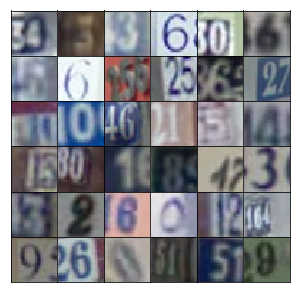

In [38]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [39]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [40]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [41]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [42]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4*4*512, activation=None)
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha * x1, x1)
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, 2, 'same', activation=None)
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha * x2, x2)
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, 2, 'same', activation=None)
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha * x3, x3)
        
        
        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, 2, 'same', activation=None)        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [43]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        conv1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same', activation=None)
        x1 = tf.maximum(alpha * conv1, conv1)
        
        # Input is 16x16x32
        x2 = tf.layers.conv2d(x1, 128, 5, strides=2, padding='same', activation=None)
        x2 = tf.layers.batch_normalization(x2, training=True)
        x2 = tf.maximum(alpha * x2, x2)
        
        # Input is 8x8x64
        x3 = tf.layers.conv2d(x2, 256, 5, strides=2, padding='same', activation=None)
        x3 = tf.layers.batch_normalization(x3, training=True)
        x3 = tf.maximum(alpha * x3, x3)
        
        # Input is 4x4x128
        flattened = tf.reshape(x3, (-1, 4*4*256))
        
        # Inputs is (None, 4*4*128) 
        logits = tf.layers.dense(flattened, 1, activation=None)
        out = tf.nn.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [44]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [45]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [46]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [47]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [48]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [ ]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.6705... Generator Loss: 0.4623
Epoch 1/25... Discriminator Loss: 0.7515... Generator Loss: 0.9827
Epoch 1/25... Discriminator Loss: 0.1538... Generator Loss: 2.7243
Epoch 1/25... Discriminator Loss: 0.2027... Generator Loss: 2.2946
Epoch 1/25... Discriminator Loss: 0.2896... Generator Loss: 1.9100
Epoch 1/25... Discriminator Loss: 0.1122... Generator Loss: 3.2092
Epoch 1/25... Discriminator Loss: 0.1061... Generator Loss: 3.0238
Epoch 1/25... Discriminator Loss: 0.2216... Generator Loss: 2.3733
Epoch 1/25... Discriminator Loss: 0.7972... Generator Loss: 1.1579
Epoch 1/25... Discriminator Loss: 0.9191... Generator Loss: 1.4699


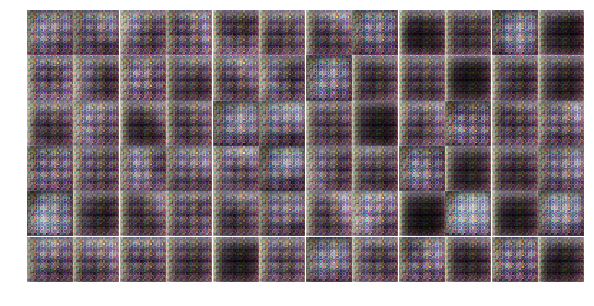

Epoch 1/25... Discriminator Loss: 0.5122... Generator Loss: 1.7434
Epoch 1/25... Discriminator Loss: 0.6247... Generator Loss: 2.5236
Epoch 1/25... Discriminator Loss: 0.7600... Generator Loss: 1.1804
Epoch 1/25... Discriminator Loss: 0.3500... Generator Loss: 3.6132
Epoch 1/25... Discriminator Loss: 0.6653... Generator Loss: 1.7527
Epoch 1/25... Discriminator Loss: 0.4479... Generator Loss: 1.7201
Epoch 1/25... Discriminator Loss: 0.1795... Generator Loss: 3.2124
Epoch 1/25... Discriminator Loss: 0.3815... Generator Loss: 2.2546
Epoch 1/25... Discriminator Loss: 0.9551... Generator Loss: 1.8185
Epoch 1/25... Discriminator Loss: 0.4927... Generator Loss: 3.9697


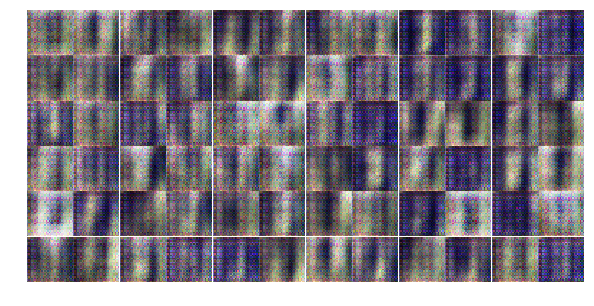

Epoch 1/25... Discriminator Loss: 0.8361... Generator Loss: 0.7007
Epoch 1/25... Discriminator Loss: 1.0959... Generator Loss: 0.5685
Epoch 1/25... Discriminator Loss: 2.3468... Generator Loss: 0.3976
Epoch 1/25... Discriminator Loss: 0.3267... Generator Loss: 1.7589
Epoch 1/25... Discriminator Loss: 0.3819... Generator Loss: 3.6573
Epoch 1/25... Discriminator Loss: 1.0332... Generator Loss: 1.5040
Epoch 1/25... Discriminator Loss: 1.0445... Generator Loss: 1.4940
Epoch 1/25... Discriminator Loss: 0.5532... Generator Loss: 1.3651
Epoch 1/25... Discriminator Loss: 0.4461... Generator Loss: 2.2879
Epoch 1/25... Discriminator Loss: 0.0978... Generator Loss: 4.1006


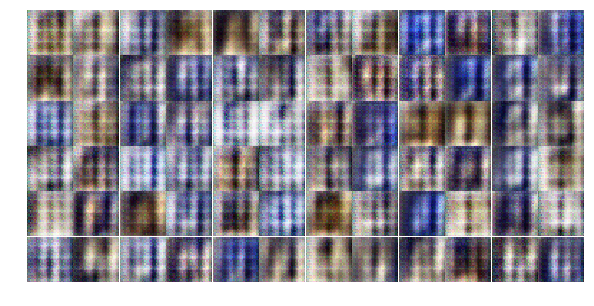

Epoch 1/25... Discriminator Loss: 0.4195... Generator Loss: 1.7768
Epoch 1/25... Discriminator Loss: 0.6692... Generator Loss: 1.0483
Epoch 1/25... Discriminator Loss: 0.2543... Generator Loss: 2.3250
Epoch 1/25... Discriminator Loss: 0.1788... Generator Loss: 3.0231
Epoch 1/25... Discriminator Loss: 1.5861... Generator Loss: 0.5218
Epoch 1/25... Discriminator Loss: 0.5697... Generator Loss: 1.7878
Epoch 1/25... Discriminator Loss: 0.5773... Generator Loss: 1.3903
Epoch 1/25... Discriminator Loss: 0.3711... Generator Loss: 1.7377
Epoch 1/25... Discriminator Loss: 0.2117... Generator Loss: 2.5436
Epoch 1/25... Discriminator Loss: 0.6780... Generator Loss: 2.1907


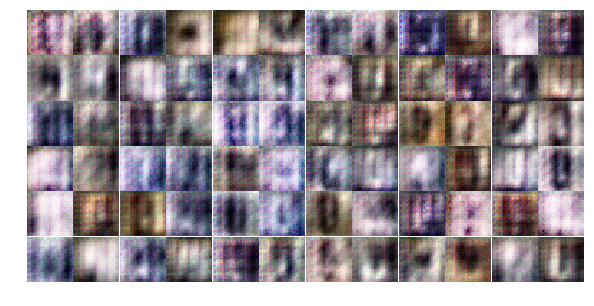

Epoch 1/25... Discriminator Loss: 0.6365... Generator Loss: 1.7776
Epoch 1/25... Discriminator Loss: 1.2258... Generator Loss: 0.7546
Epoch 1/25... Discriminator Loss: 0.6026... Generator Loss: 1.6567
Epoch 1/25... Discriminator Loss: 0.4932... Generator Loss: 2.5068
Epoch 1/25... Discriminator Loss: 0.6521... Generator Loss: 1.5942
Epoch 1/25... Discriminator Loss: 1.0209... Generator Loss: 0.7464
Epoch 1/25... Discriminator Loss: 0.4514... Generator Loss: 1.7671
Epoch 1/25... Discriminator Loss: 0.9241... Generator Loss: 2.2319
Epoch 1/25... Discriminator Loss: 0.3534... Generator Loss: 1.9783
Epoch 1/25... Discriminator Loss: 1.1434... Generator Loss: 0.5889


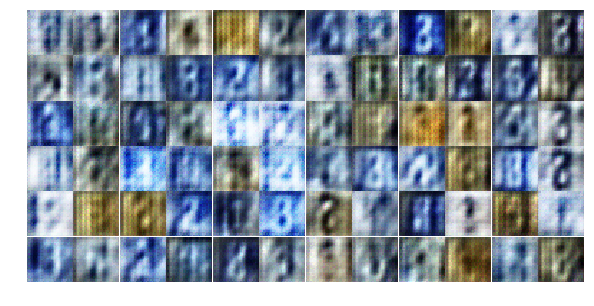

Epoch 1/25... Discriminator Loss: 0.5417... Generator Loss: 2.4337
Epoch 1/25... Discriminator Loss: 0.8466... Generator Loss: 1.2059
Epoch 1/25... Discriminator Loss: 0.7000... Generator Loss: 1.2136
Epoch 1/25... Discriminator Loss: 0.7787... Generator Loss: 1.3463
Epoch 1/25... Discriminator Loss: 0.4451... Generator Loss: 1.6815
Epoch 1/25... Discriminator Loss: 0.6910... Generator Loss: 1.2970
Epoch 1/25... Discriminator Loss: 0.5189... Generator Loss: 1.7291
Epoch 2/25... Discriminator Loss: 0.5562... Generator Loss: 1.8263
Epoch 2/25... Discriminator Loss: 0.7490... Generator Loss: 2.3712
Epoch 2/25... Discriminator Loss: 0.9409... Generator Loss: 1.0215


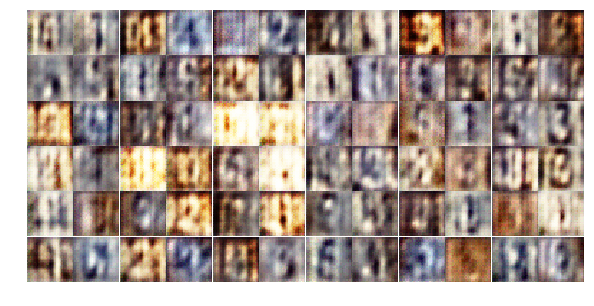

Epoch 2/25... Discriminator Loss: 0.6665... Generator Loss: 1.3307
Epoch 2/25... Discriminator Loss: 0.8795... Generator Loss: 1.3941
Epoch 2/25... Discriminator Loss: 1.0344... Generator Loss: 0.9458
Epoch 2/25... Discriminator Loss: 0.7681... Generator Loss: 1.6219
Epoch 2/25... Discriminator Loss: 1.2912... Generator Loss: 1.1463
Epoch 2/25... Discriminator Loss: 1.1157... Generator Loss: 0.9293
Epoch 2/25... Discriminator Loss: 0.7936... Generator Loss: 1.3444
Epoch 2/25... Discriminator Loss: 0.7463... Generator Loss: 1.4391
Epoch 2/25... Discriminator Loss: 0.9944... Generator Loss: 0.7990
Epoch 2/25... Discriminator Loss: 0.9216... Generator Loss: 1.6309


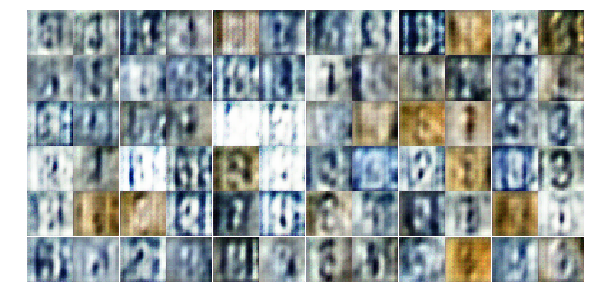

Epoch 2/25... Discriminator Loss: 1.0459... Generator Loss: 0.9411
Epoch 2/25... Discriminator Loss: 0.6728... Generator Loss: 1.5711
Epoch 2/25... Discriminator Loss: 0.8484... Generator Loss: 1.6427
Epoch 2/25... Discriminator Loss: 0.9249... Generator Loss: 1.1646
Epoch 2/25... Discriminator Loss: 0.9223... Generator Loss: 1.5985
Epoch 2/25... Discriminator Loss: 1.2996... Generator Loss: 0.7698
Epoch 2/25... Discriminator Loss: 1.3402... Generator Loss: 1.2995
Epoch 2/25... Discriminator Loss: 0.8838... Generator Loss: 0.8303
Epoch 2/25... Discriminator Loss: 1.1012... Generator Loss: 1.3931
Epoch 2/25... Discriminator Loss: 1.0853... Generator Loss: 0.6357


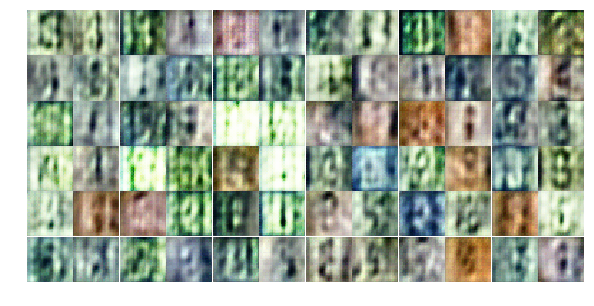

Epoch 2/25... Discriminator Loss: 1.1407... Generator Loss: 0.8703
Epoch 2/25... Discriminator Loss: 0.9321... Generator Loss: 0.9801
Epoch 2/25... Discriminator Loss: 0.9493... Generator Loss: 1.0732
Epoch 2/25... Discriminator Loss: 0.9746... Generator Loss: 1.4790
Epoch 2/25... Discriminator Loss: 0.9425... Generator Loss: 1.4757
Epoch 2/25... Discriminator Loss: 0.9261... Generator Loss: 1.1171
Epoch 2/25... Discriminator Loss: 0.7813... Generator Loss: 1.1799
Epoch 2/25... Discriminator Loss: 0.7643... Generator Loss: 1.0583
Epoch 2/25... Discriminator Loss: 1.3468... Generator Loss: 0.6167
Epoch 2/25... Discriminator Loss: 0.7361... Generator Loss: 1.4602


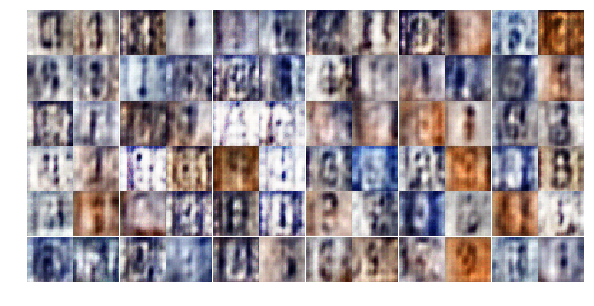

Epoch 2/25... Discriminator Loss: 1.2902... Generator Loss: 0.8718
Epoch 2/25... Discriminator Loss: 1.0815... Generator Loss: 0.9278
Epoch 2/25... Discriminator Loss: 1.1678... Generator Loss: 0.7307
Epoch 2/25... Discriminator Loss: 1.2150... Generator Loss: 0.6652
Epoch 2/25... Discriminator Loss: 1.1028... Generator Loss: 1.3556
Epoch 2/25... Discriminator Loss: 0.9729... Generator Loss: 1.2795
Epoch 2/25... Discriminator Loss: 1.0848... Generator Loss: 1.0368
Epoch 2/25... Discriminator Loss: 0.9743... Generator Loss: 1.1519
Epoch 2/25... Discriminator Loss: 1.2397... Generator Loss: 0.9376
Epoch 2/25... Discriminator Loss: 0.7819... Generator Loss: 1.2288


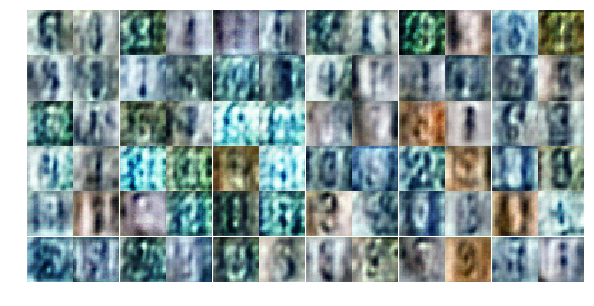

Epoch 2/25... Discriminator Loss: 1.1115... Generator Loss: 1.2167
Epoch 2/25... Discriminator Loss: 0.8824... Generator Loss: 1.3839
Epoch 2/25... Discriminator Loss: 0.9187... Generator Loss: 0.9816
Epoch 2/25... Discriminator Loss: 0.9401... Generator Loss: 0.8580
Epoch 2/25... Discriminator Loss: 0.9636... Generator Loss: 0.9996
Epoch 2/25... Discriminator Loss: 0.9831... Generator Loss: 1.0002
Epoch 2/25... Discriminator Loss: 0.7891... Generator Loss: 1.6468
Epoch 2/25... Discriminator Loss: 1.0455... Generator Loss: 0.9490
Epoch 2/25... Discriminator Loss: 0.5905... Generator Loss: 1.4737
Epoch 2/25... Discriminator Loss: 0.7202... Generator Loss: 1.4999


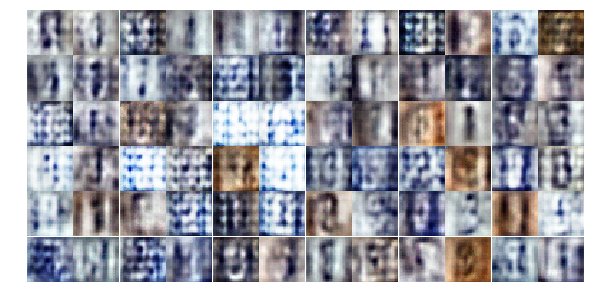

Epoch 2/25... Discriminator Loss: 0.9713... Generator Loss: 1.1524
Epoch 2/25... Discriminator Loss: 1.0788... Generator Loss: 1.0122
Epoch 2/25... Discriminator Loss: 0.8399... Generator Loss: 1.0534
Epoch 2/25... Discriminator Loss: 1.0348... Generator Loss: 0.9617
Epoch 3/25... Discriminator Loss: 0.7807... Generator Loss: 1.9209
Epoch 3/25... Discriminator Loss: 1.0501... Generator Loss: 0.9213
Epoch 3/25... Discriminator Loss: 0.8649... Generator Loss: 1.2300
Epoch 3/25... Discriminator Loss: 0.8115... Generator Loss: 1.2882
Epoch 3/25... Discriminator Loss: 1.0389... Generator Loss: 1.2837
Epoch 3/25... Discriminator Loss: 0.8893... Generator Loss: 1.2988


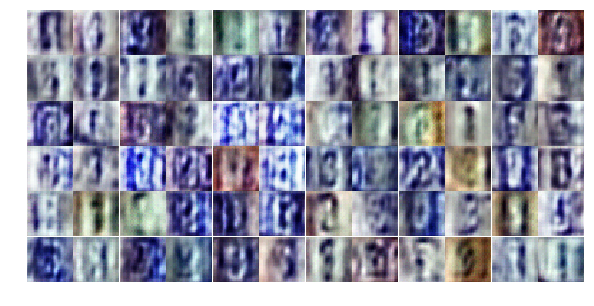

Epoch 3/25... Discriminator Loss: 1.0405... Generator Loss: 0.9655
Epoch 3/25... Discriminator Loss: 0.8291... Generator Loss: 1.3637
Epoch 3/25... Discriminator Loss: 1.1193... Generator Loss: 0.8589
Epoch 3/25... Discriminator Loss: 0.8530... Generator Loss: 1.1348
Epoch 3/25... Discriminator Loss: 0.6037... Generator Loss: 1.3883
Epoch 3/25... Discriminator Loss: 1.0711... Generator Loss: 0.6640
Epoch 3/25... Discriminator Loss: 0.7164... Generator Loss: 1.2277
Epoch 3/25... Discriminator Loss: 0.5327... Generator Loss: 1.4809
Epoch 3/25... Discriminator Loss: 0.7075... Generator Loss: 1.0895
Epoch 3/25... Discriminator Loss: 0.9194... Generator Loss: 0.7807


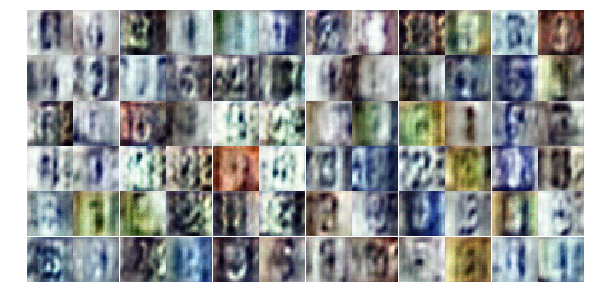

Epoch 3/25... Discriminator Loss: 0.8862... Generator Loss: 1.3372
Epoch 3/25... Discriminator Loss: 0.6686... Generator Loss: 1.3022
Epoch 3/25... Discriminator Loss: 0.6095... Generator Loss: 1.5016
Epoch 3/25... Discriminator Loss: 1.3205... Generator Loss: 2.7269
Epoch 3/25... Discriminator Loss: 0.8602... Generator Loss: 1.6726
Epoch 3/25... Discriminator Loss: 0.9098... Generator Loss: 1.4438
Epoch 3/25... Discriminator Loss: 0.7240... Generator Loss: 1.0058
Epoch 3/25... Discriminator Loss: 0.9139... Generator Loss: 1.8468
Epoch 3/25... Discriminator Loss: 0.9423... Generator Loss: 2.4314
Epoch 3/25... Discriminator Loss: 0.6502... Generator Loss: 1.3466


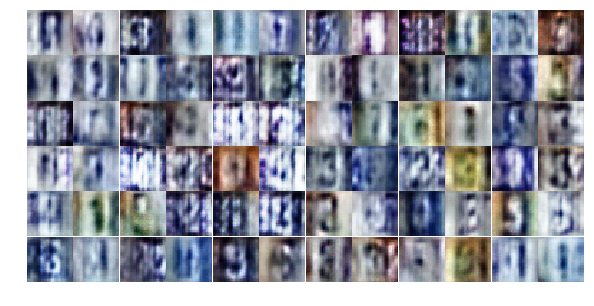

Epoch 3/25... Discriminator Loss: 0.6651... Generator Loss: 1.4030
Epoch 3/25... Discriminator Loss: 0.6719... Generator Loss: 1.2057
Epoch 3/25... Discriminator Loss: 0.7125... Generator Loss: 1.4057
Epoch 3/25... Discriminator Loss: 0.5871... Generator Loss: 1.2944
Epoch 3/25... Discriminator Loss: 0.8605... Generator Loss: 0.9575
Epoch 3/25... Discriminator Loss: 0.8251... Generator Loss: 1.2388
Epoch 3/25... Discriminator Loss: 0.6943... Generator Loss: 1.2576
Epoch 3/25... Discriminator Loss: 0.7266... Generator Loss: 1.7641
Epoch 3/25... Discriminator Loss: 0.7839... Generator Loss: 0.9061
Epoch 3/25... Discriminator Loss: 0.6951... Generator Loss: 1.1275


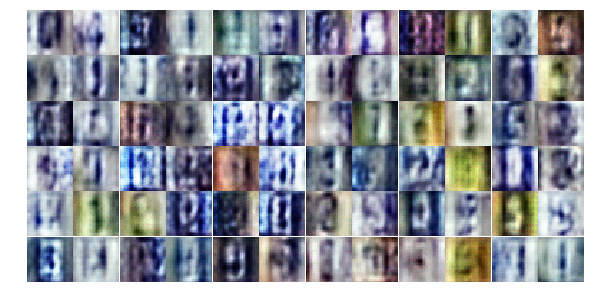

Epoch 3/25... Discriminator Loss: 0.5664... Generator Loss: 1.5258
Epoch 3/25... Discriminator Loss: 0.4833... Generator Loss: 1.9375
Epoch 3/25... Discriminator Loss: 0.5287... Generator Loss: 1.6440
Epoch 3/25... Discriminator Loss: 0.9582... Generator Loss: 0.9353
Epoch 3/25... Discriminator Loss: 0.7156... Generator Loss: 2.8258
Epoch 3/25... Discriminator Loss: 0.5502... Generator Loss: 1.5218
Epoch 3/25... Discriminator Loss: 0.8816... Generator Loss: 2.1854
Epoch 3/25... Discriminator Loss: 0.4742... Generator Loss: 1.6122
Epoch 3/25... Discriminator Loss: 0.6710... Generator Loss: 1.3647
Epoch 3/25... Discriminator Loss: 0.5923... Generator Loss: 1.3762


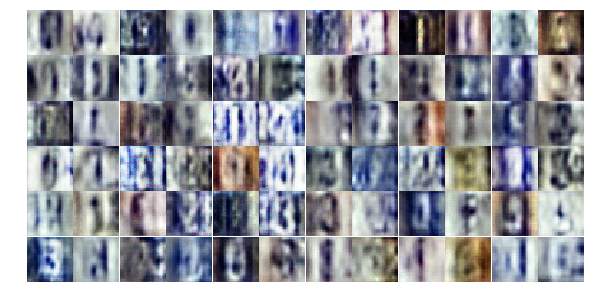

Epoch 3/25... Discriminator Loss: 1.1515... Generator Loss: 2.8048
Epoch 3/25... Discriminator Loss: 0.5682... Generator Loss: 1.5875
Epoch 3/25... Discriminator Loss: 1.5256... Generator Loss: 0.3997
Epoch 3/25... Discriminator Loss: 0.5089... Generator Loss: 1.8261
Epoch 3/25... Discriminator Loss: 0.9836... Generator Loss: 0.6852
Epoch 3/25... Discriminator Loss: 0.5181... Generator Loss: 2.1651
Epoch 3/25... Discriminator Loss: 0.7296... Generator Loss: 1.4943
Epoch 3/25... Discriminator Loss: 0.7613... Generator Loss: 1.6035
Epoch 3/25... Discriminator Loss: 0.9195... Generator Loss: 0.7226
Epoch 3/25... Discriminator Loss: 0.4044... Generator Loss: 2.3418


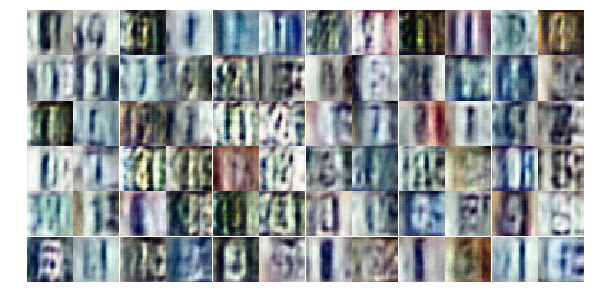

Epoch 3/25... Discriminator Loss: 1.2650... Generator Loss: 0.5350
Epoch 4/25... Discriminator Loss: 0.7902... Generator Loss: 0.9779
Epoch 4/25... Discriminator Loss: 1.3245... Generator Loss: 0.4519
Epoch 4/25... Discriminator Loss: 0.6117... Generator Loss: 1.2624
Epoch 4/25... Discriminator Loss: 0.4715... Generator Loss: 1.8549
Epoch 4/25... Discriminator Loss: 0.6248... Generator Loss: 1.5314
Epoch 4/25... Discriminator Loss: 0.9655... Generator Loss: 0.7781
Epoch 4/25... Discriminator Loss: 0.7028... Generator Loss: 1.1619
Epoch 4/25... Discriminator Loss: 0.6849... Generator Loss: 1.8983
Epoch 4/25... Discriminator Loss: 0.6466... Generator Loss: 1.5281


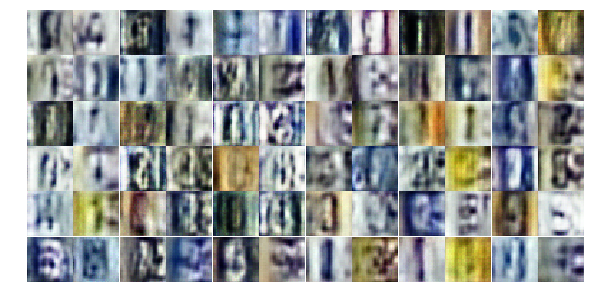

Epoch 4/25... Discriminator Loss: 0.4962... Generator Loss: 1.4356
Epoch 4/25... Discriminator Loss: 0.8886... Generator Loss: 0.7509
Epoch 4/25... Discriminator Loss: 0.7921... Generator Loss: 1.2986
Epoch 4/25... Discriminator Loss: 0.6012... Generator Loss: 1.2322
Epoch 4/25... Discriminator Loss: 0.7866... Generator Loss: 0.9948
Epoch 4/25... Discriminator Loss: 1.4479... Generator Loss: 0.3422
Epoch 4/25... Discriminator Loss: 0.8010... Generator Loss: 1.5469
Epoch 4/25... Discriminator Loss: 0.7409... Generator Loss: 0.8302
Epoch 4/25... Discriminator Loss: 0.7934... Generator Loss: 2.4072
Epoch 4/25... Discriminator Loss: 0.5341... Generator Loss: 1.9105


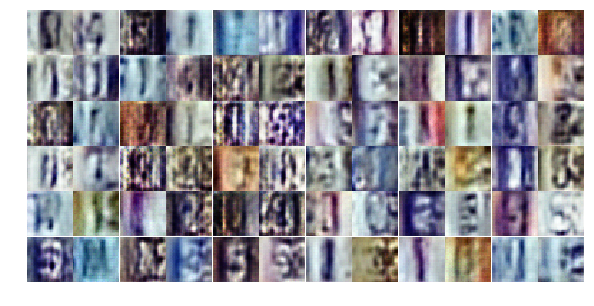

Epoch 4/25... Discriminator Loss: 0.5521... Generator Loss: 1.2886
Epoch 4/25... Discriminator Loss: 0.6097... Generator Loss: 3.7781
Epoch 4/25... Discriminator Loss: 1.2736... Generator Loss: 0.4236
Epoch 4/25... Discriminator Loss: 0.5151... Generator Loss: 1.5003
Epoch 4/25... Discriminator Loss: 0.4007... Generator Loss: 1.6127
Epoch 4/25... Discriminator Loss: 1.5270... Generator Loss: 4.1567
Epoch 4/25... Discriminator Loss: 1.5236... Generator Loss: 0.3861
Epoch 4/25... Discriminator Loss: 0.9476... Generator Loss: 0.7072
Epoch 4/25... Discriminator Loss: 0.3610... Generator Loss: 1.9821
Epoch 4/25... Discriminator Loss: 0.3300... Generator Loss: 1.8496


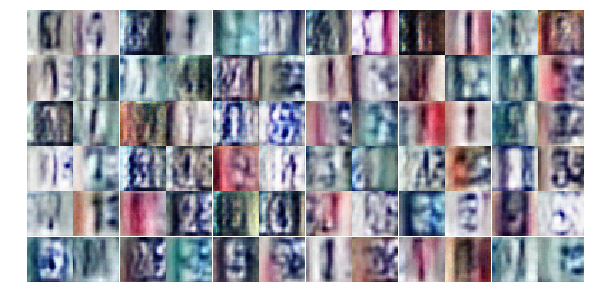

Epoch 4/25... Discriminator Loss: 0.3444... Generator Loss: 2.2508
Epoch 4/25... Discriminator Loss: 0.5368... Generator Loss: 1.4423
Epoch 4/25... Discriminator Loss: 0.6036... Generator Loss: 1.9595
Epoch 4/25... Discriminator Loss: 0.4211... Generator Loss: 2.0405
Epoch 4/25... Discriminator Loss: 0.3107... Generator Loss: 2.1623
Epoch 4/25... Discriminator Loss: 0.2662... Generator Loss: 3.9097
Epoch 4/25... Discriminator Loss: 0.5121... Generator Loss: 1.7531
Epoch 4/25... Discriminator Loss: 0.7738... Generator Loss: 2.8725
Epoch 4/25... Discriminator Loss: 0.3806... Generator Loss: 2.0334
Epoch 4/25... Discriminator Loss: 0.6385... Generator Loss: 1.0788


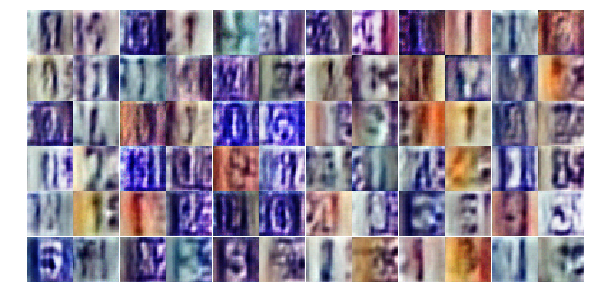

Epoch 4/25... Discriminator Loss: 0.4176... Generator Loss: 1.5131
Epoch 4/25... Discriminator Loss: 0.5685... Generator Loss: 2.4262
Epoch 4/25... Discriminator Loss: 1.6263... Generator Loss: 3.7283
Epoch 4/25... Discriminator Loss: 0.8440... Generator Loss: 2.4668
Epoch 4/25... Discriminator Loss: 0.3603... Generator Loss: 2.0749
Epoch 4/25... Discriminator Loss: 0.3942... Generator Loss: 1.8578
Epoch 4/25... Discriminator Loss: 0.5672... Generator Loss: 1.2349
Epoch 4/25... Discriminator Loss: 0.4862... Generator Loss: 1.5891
Epoch 4/25... Discriminator Loss: 0.4434... Generator Loss: 1.6385
Epoch 4/25... Discriminator Loss: 0.7060... Generator Loss: 2.1495


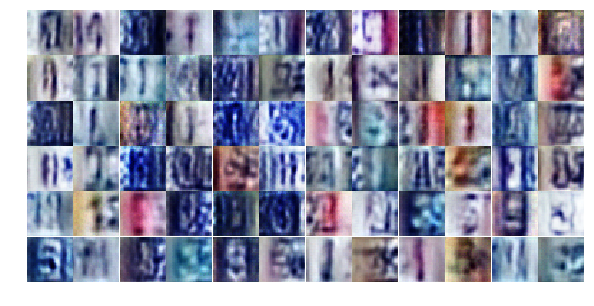

Epoch 4/25... Discriminator Loss: 0.4351... Generator Loss: 1.5316
Epoch 4/25... Discriminator Loss: 0.4778... Generator Loss: 1.2935
Epoch 4/25... Discriminator Loss: 0.5341... Generator Loss: 3.3682
Epoch 4/25... Discriminator Loss: 0.8208... Generator Loss: 2.2306
Epoch 4/25... Discriminator Loss: 0.6965... Generator Loss: 1.0760
Epoch 4/25... Discriminator Loss: 0.5747... Generator Loss: 1.7406
Epoch 4/25... Discriminator Loss: 0.2062... Generator Loss: 2.8993
Epoch 4/25... Discriminator Loss: 0.7679... Generator Loss: 0.9268
Epoch 4/25... Discriminator Loss: 0.5527... Generator Loss: 1.8485
Epoch 5/25... Discriminator Loss: 0.4912... Generator Loss: 1.3097


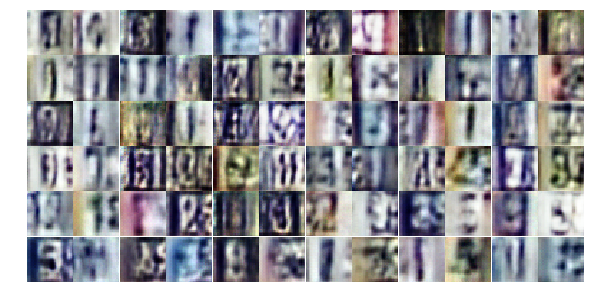

Epoch 5/25... Discriminator Loss: 0.3619... Generator Loss: 1.7149
Epoch 5/25... Discriminator Loss: 1.0237... Generator Loss: 1.7912
Epoch 5/25... Discriminator Loss: 0.7191... Generator Loss: 0.9087
Epoch 5/25... Discriminator Loss: 0.3881... Generator Loss: 1.5502
Epoch 5/25... Discriminator Loss: 0.3828... Generator Loss: 1.9309
Epoch 5/25... Discriminator Loss: 0.5508... Generator Loss: 1.4498
Epoch 5/25... Discriminator Loss: 0.4794... Generator Loss: 1.3214
Epoch 5/25... Discriminator Loss: 0.6637... Generator Loss: 0.9810
Epoch 5/25... Discriminator Loss: 0.4251... Generator Loss: 2.3205
Epoch 5/25... Discriminator Loss: 1.1711... Generator Loss: 0.5762


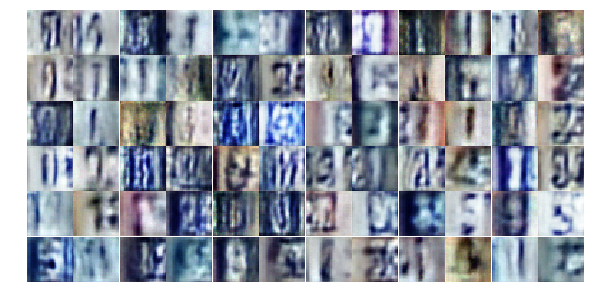

Epoch 5/25... Discriminator Loss: 2.1043... Generator Loss: 4.1228
Epoch 5/25... Discriminator Loss: 0.6416... Generator Loss: 1.6081
Epoch 5/25... Discriminator Loss: 0.3614... Generator Loss: 1.7050
Epoch 5/25... Discriminator Loss: 0.3667... Generator Loss: 1.7770
Epoch 5/25... Discriminator Loss: 0.3325... Generator Loss: 1.9244
Epoch 5/25... Discriminator Loss: 1.7780... Generator Loss: 0.3062
Epoch 5/25... Discriminator Loss: 0.7261... Generator Loss: 0.9987
Epoch 5/25... Discriminator Loss: 0.3882... Generator Loss: 2.1867
Epoch 5/25... Discriminator Loss: 0.3923... Generator Loss: 1.8776
Epoch 5/25... Discriminator Loss: 0.3522... Generator Loss: 1.9722


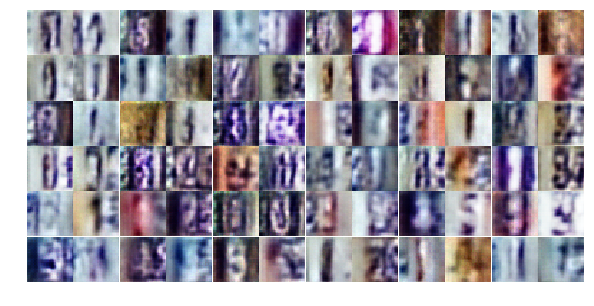

Epoch 5/25... Discriminator Loss: 0.4811... Generator Loss: 1.3763
Epoch 5/25... Discriminator Loss: 0.6740... Generator Loss: 2.4524
Epoch 5/25... Discriminator Loss: 0.7436... Generator Loss: 0.9431
Epoch 5/25... Discriminator Loss: 0.6902... Generator Loss: 1.0031
Epoch 5/25... Discriminator Loss: 0.5262... Generator Loss: 1.1318
Epoch 5/25... Discriminator Loss: 0.6778... Generator Loss: 1.0062
Epoch 5/25... Discriminator Loss: 0.5611... Generator Loss: 1.1024
Epoch 5/25... Discriminator Loss: 0.3736... Generator Loss: 2.3901
Epoch 5/25... Discriminator Loss: 1.0369... Generator Loss: 0.6988
Epoch 5/25... Discriminator Loss: 0.6908... Generator Loss: 2.7777


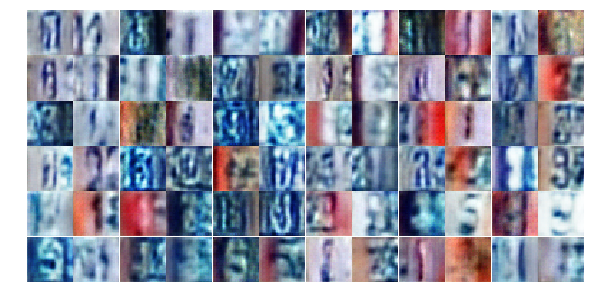

Epoch 5/25... Discriminator Loss: 0.8269... Generator Loss: 0.9415
Epoch 5/25... Discriminator Loss: 0.4371... Generator Loss: 1.7556
Epoch 5/25... Discriminator Loss: 0.7014... Generator Loss: 1.0275
Epoch 5/25... Discriminator Loss: 0.4723... Generator Loss: 1.4022
Epoch 5/25... Discriminator Loss: 0.9238... Generator Loss: 1.0814
Epoch 5/25... Discriminator Loss: 0.6517... Generator Loss: 2.1385
Epoch 5/25... Discriminator Loss: 0.7046... Generator Loss: 0.9688
Epoch 5/25... Discriminator Loss: 0.4952... Generator Loss: 1.3559
Epoch 5/25... Discriminator Loss: 0.4243... Generator Loss: 1.4888
Epoch 5/25... Discriminator Loss: 0.7277... Generator Loss: 0.8907


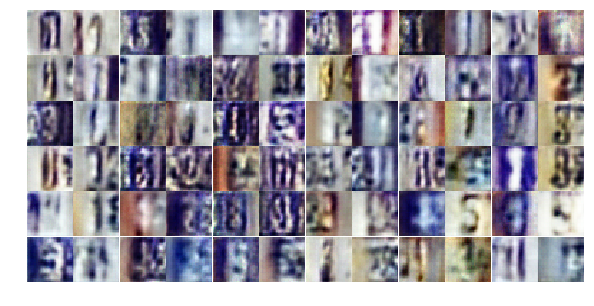

Epoch 5/25... Discriminator Loss: 0.3885... Generator Loss: 1.8698
Epoch 5/25... Discriminator Loss: 0.5490... Generator Loss: 1.1952
Epoch 5/25... Discriminator Loss: 1.1786... Generator Loss: 0.4848
Epoch 5/25... Discriminator Loss: 0.5641... Generator Loss: 1.5869
Epoch 5/25... Discriminator Loss: 0.9837... Generator Loss: 0.8028
Epoch 5/25... Discriminator Loss: 0.6681... Generator Loss: 1.2907
Epoch 5/25... Discriminator Loss: 0.5558... Generator Loss: 1.2403
Epoch 5/25... Discriminator Loss: 1.1336... Generator Loss: 0.5502
Epoch 5/25... Discriminator Loss: 0.7350... Generator Loss: 0.8897
Epoch 5/25... Discriminator Loss: 0.4429... Generator Loss: 1.7135


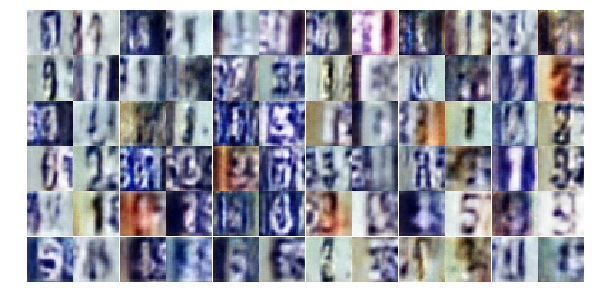

Epoch 5/25... Discriminator Loss: 0.9593... Generator Loss: 1.0658
Epoch 5/25... Discriminator Loss: 1.7170... Generator Loss: 0.3302
Epoch 5/25... Discriminator Loss: 0.9193... Generator Loss: 0.8695
Epoch 5/25... Discriminator Loss: 0.7636... Generator Loss: 1.2144
Epoch 5/25... Discriminator Loss: 0.4919... Generator Loss: 1.5109
Epoch 5/25... Discriminator Loss: 0.7240... Generator Loss: 1.5296
Epoch 6/25... Discriminator Loss: 0.7307... Generator Loss: 0.9869
Epoch 6/25... Discriminator Loss: 0.4451... Generator Loss: 1.5327
Epoch 6/25... Discriminator Loss: 0.4515... Generator Loss: 1.4919
Epoch 6/25... Discriminator Loss: 1.6659... Generator Loss: 0.2953


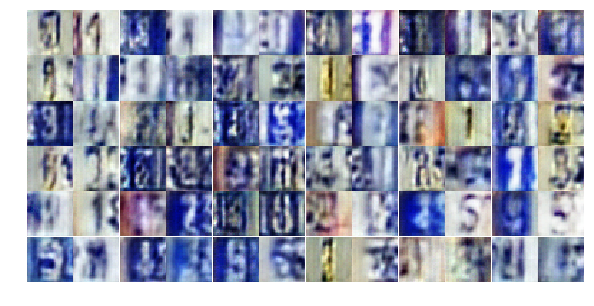

Epoch 6/25... Discriminator Loss: 0.5321... Generator Loss: 1.7539
Epoch 6/25... Discriminator Loss: 0.7164... Generator Loss: 0.9834
Epoch 6/25... Discriminator Loss: 0.7996... Generator Loss: 1.4863
Epoch 6/25... Discriminator Loss: 0.8744... Generator Loss: 0.8644
Epoch 6/25... Discriminator Loss: 0.7647... Generator Loss: 0.8754
Epoch 6/25... Discriminator Loss: 0.6729... Generator Loss: 0.9964
Epoch 6/25... Discriminator Loss: 0.5141... Generator Loss: 1.9143
Epoch 6/25... Discriminator Loss: 0.9472... Generator Loss: 0.6498
Epoch 6/25... Discriminator Loss: 0.7716... Generator Loss: 0.8443
Epoch 6/25... Discriminator Loss: 0.6965... Generator Loss: 1.2138


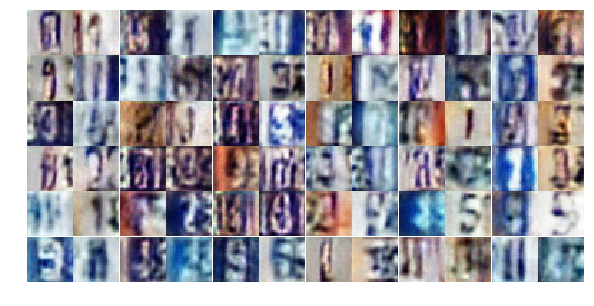

Epoch 6/25... Discriminator Loss: 0.6677... Generator Loss: 1.5670
Epoch 6/25... Discriminator Loss: 0.6302... Generator Loss: 1.6491
Epoch 6/25... Discriminator Loss: 1.0613... Generator Loss: 0.5877
Epoch 6/25... Discriminator Loss: 0.7229... Generator Loss: 0.8735
Epoch 6/25... Discriminator Loss: 0.2526... Generator Loss: 2.4678
Epoch 6/25... Discriminator Loss: 0.5616... Generator Loss: 1.3044
Epoch 6/25... Discriminator Loss: 0.5859... Generator Loss: 1.3174
Epoch 6/25... Discriminator Loss: 0.7806... Generator Loss: 1.2795
Epoch 6/25... Discriminator Loss: 0.6225... Generator Loss: 2.4713
Epoch 6/25... Discriminator Loss: 0.8994... Generator Loss: 0.7357


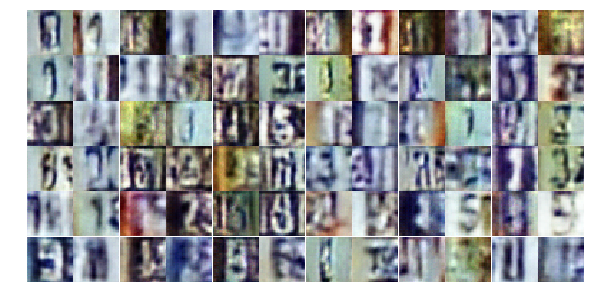

Epoch 6/25... Discriminator Loss: 0.6786... Generator Loss: 1.0558
Epoch 6/25... Discriminator Loss: 0.4665... Generator Loss: 1.8024
Epoch 6/25... Discriminator Loss: 1.5513... Generator Loss: 0.3535
Epoch 6/25... Discriminator Loss: 0.8549... Generator Loss: 0.9540
Epoch 6/25... Discriminator Loss: 0.4761... Generator Loss: 1.4823
Epoch 6/25... Discriminator Loss: 1.3770... Generator Loss: 0.4429
Epoch 6/25... Discriminator Loss: 0.8064... Generator Loss: 0.8043
Epoch 6/25... Discriminator Loss: 0.3248... Generator Loss: 1.7758
Epoch 6/25... Discriminator Loss: 0.6054... Generator Loss: 1.1698
Epoch 6/25... Discriminator Loss: 0.4708... Generator Loss: 1.6698


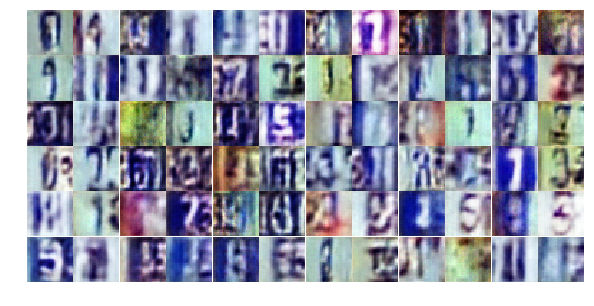

Epoch 6/25... Discriminator Loss: 1.2644... Generator Loss: 0.4997
Epoch 6/25... Discriminator Loss: 0.6628... Generator Loss: 1.2444
Epoch 6/25... Discriminator Loss: 1.4167... Generator Loss: 0.6598
Epoch 6/25... Discriminator Loss: 0.6381... Generator Loss: 1.1211
Epoch 6/25... Discriminator Loss: 0.7443... Generator Loss: 1.9832
Epoch 6/25... Discriminator Loss: 0.5709... Generator Loss: 1.3632
Epoch 6/25... Discriminator Loss: 0.5022... Generator Loss: 1.4101
Epoch 6/25... Discriminator Loss: 0.4778... Generator Loss: 1.8392
Epoch 6/25... Discriminator Loss: 1.1932... Generator Loss: 0.5078
Epoch 6/25... Discriminator Loss: 0.3409... Generator Loss: 2.0423


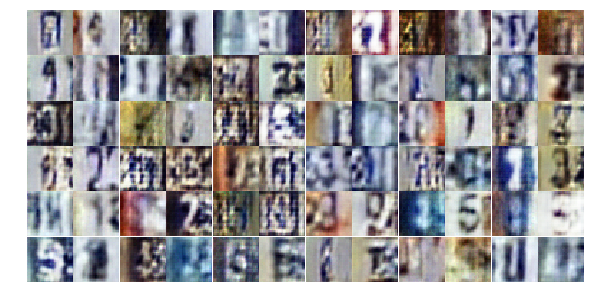

Epoch 6/25... Discriminator Loss: 1.1361... Generator Loss: 1.5161
Epoch 6/25... Discriminator Loss: 0.6925... Generator Loss: 1.5691
Epoch 6/25... Discriminator Loss: 0.9311... Generator Loss: 0.7242
Epoch 6/25... Discriminator Loss: 0.6242... Generator Loss: 1.5935
Epoch 6/25... Discriminator Loss: 0.8100... Generator Loss: 2.7391
Epoch 6/25... Discriminator Loss: 0.5473... Generator Loss: 1.5908
Epoch 6/25... Discriminator Loss: 0.8012... Generator Loss: 0.8682
Epoch 6/25... Discriminator Loss: 1.2588... Generator Loss: 0.4740
Epoch 6/25... Discriminator Loss: 0.6544... Generator Loss: 1.1900
Epoch 6/25... Discriminator Loss: 1.5967... Generator Loss: 0.3419


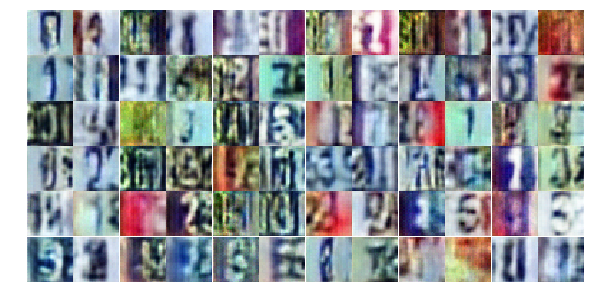

Epoch 6/25... Discriminator Loss: 0.5807... Generator Loss: 1.6446
Epoch 6/25... Discriminator Loss: 0.7444... Generator Loss: 0.8770
Epoch 6/25... Discriminator Loss: 0.6087... Generator Loss: 1.6018
Epoch 7/25... Discriminator Loss: 0.6018... Generator Loss: 1.1662
Epoch 7/25... Discriminator Loss: 0.5739... Generator Loss: 1.2934
Epoch 7/25... Discriminator Loss: 0.9229... Generator Loss: 0.6978
Epoch 7/25... Discriminator Loss: 0.3709... Generator Loss: 2.0176
Epoch 7/25... Discriminator Loss: 0.4172... Generator Loss: 1.6252
Epoch 7/25... Discriminator Loss: 1.7869... Generator Loss: 4.3817
Epoch 7/25... Discriminator Loss: 0.8938... Generator Loss: 1.3613


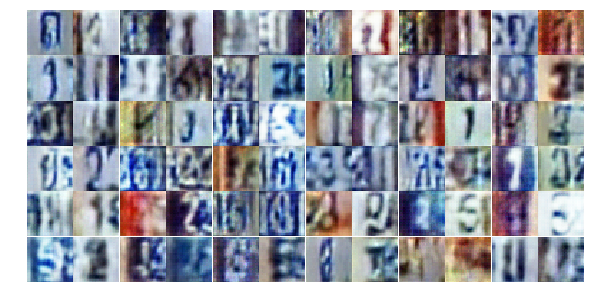

Epoch 7/25... Discriminator Loss: 0.7389... Generator Loss: 1.2289
Epoch 7/25... Discriminator Loss: 0.8613... Generator Loss: 0.8286
Epoch 7/25... Discriminator Loss: 0.8547... Generator Loss: 0.7755
Epoch 7/25... Discriminator Loss: 0.6988... Generator Loss: 1.7364
Epoch 7/25... Discriminator Loss: 0.3395... Generator Loss: 1.7287
Epoch 7/25... Discriminator Loss: 0.4120... Generator Loss: 1.9438
Epoch 7/25... Discriminator Loss: 0.9093... Generator Loss: 2.7518
Epoch 7/25... Discriminator Loss: 0.6842... Generator Loss: 2.0133
Epoch 7/25... Discriminator Loss: 0.7527... Generator Loss: 2.3436
Epoch 7/25... Discriminator Loss: 0.4902... Generator Loss: 1.4864


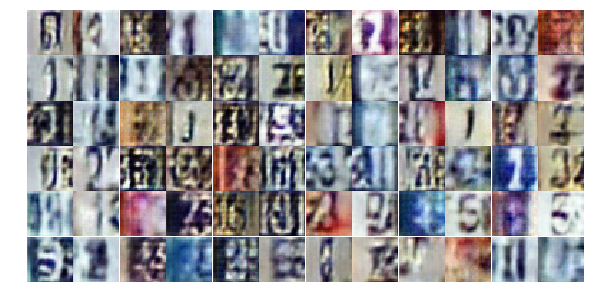

Epoch 7/25... Discriminator Loss: 0.8543... Generator Loss: 0.8035
Epoch 7/25... Discriminator Loss: 0.4573... Generator Loss: 1.7251
Epoch 7/25... Discriminator Loss: 0.8164... Generator Loss: 0.8758
Epoch 7/25... Discriminator Loss: 0.5400... Generator Loss: 1.6246
Epoch 7/25... Discriminator Loss: 0.4188... Generator Loss: 1.7606
Epoch 7/25... Discriminator Loss: 0.4881... Generator Loss: 1.5381
Epoch 7/25... Discriminator Loss: 0.6731... Generator Loss: 0.9968
Epoch 7/25... Discriminator Loss: 0.9138... Generator Loss: 0.8351
Epoch 7/25... Discriminator Loss: 0.4751... Generator Loss: 2.2691
Epoch 7/25... Discriminator Loss: 0.5427... Generator Loss: 1.6954


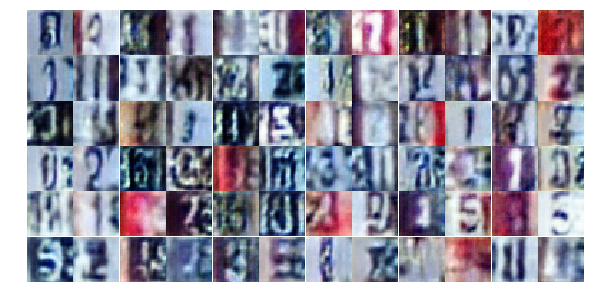

Epoch 7/25... Discriminator Loss: 0.6432... Generator Loss: 1.1345
Epoch 7/25... Discriminator Loss: 0.6268... Generator Loss: 1.6244
Epoch 7/25... Discriminator Loss: 0.5057... Generator Loss: 1.2871
Epoch 7/25... Discriminator Loss: 0.6690... Generator Loss: 1.0496
Epoch 7/25... Discriminator Loss: 0.6402... Generator Loss: 1.0087
Epoch 7/25... Discriminator Loss: 0.8695... Generator Loss: 0.7193
Epoch 7/25... Discriminator Loss: 0.8678... Generator Loss: 0.7205
Epoch 7/25... Discriminator Loss: 0.8477... Generator Loss: 1.3453
Epoch 7/25... Discriminator Loss: 1.2239... Generator Loss: 0.6317
Epoch 7/25... Discriminator Loss: 0.6551... Generator Loss: 1.3001


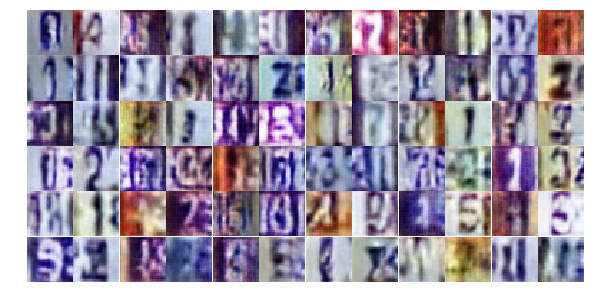

Epoch 7/25... Discriminator Loss: 1.0178... Generator Loss: 0.7798
Epoch 7/25... Discriminator Loss: 0.7137... Generator Loss: 1.1878
Epoch 7/25... Discriminator Loss: 0.4190... Generator Loss: 1.7902
Epoch 7/25... Discriminator Loss: 0.5804... Generator Loss: 1.9914
Epoch 7/25... Discriminator Loss: 0.6680... Generator Loss: 1.3517
Epoch 7/25... Discriminator Loss: 0.3552... Generator Loss: 1.8196
Epoch 7/25... Discriminator Loss: 0.5680... Generator Loss: 1.1462
Epoch 7/25... Discriminator Loss: 0.8531... Generator Loss: 2.0920
Epoch 7/25... Discriminator Loss: 0.3283... Generator Loss: 2.2941
Epoch 7/25... Discriminator Loss: 0.9368... Generator Loss: 0.7048


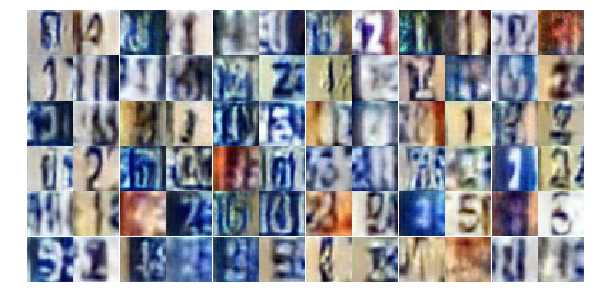

Epoch 7/25... Discriminator Loss: 0.3263... Generator Loss: 2.0522
Epoch 7/25... Discriminator Loss: 0.4542... Generator Loss: 1.4820
Epoch 7/25... Discriminator Loss: 0.5546... Generator Loss: 1.6998
Epoch 7/25... Discriminator Loss: 0.6696... Generator Loss: 1.1016
Epoch 7/25... Discriminator Loss: 0.9728... Generator Loss: 0.6405
Epoch 7/25... Discriminator Loss: 0.5128... Generator Loss: 1.5408
Epoch 7/25... Discriminator Loss: 1.8737... Generator Loss: 0.2455
Epoch 7/25... Discriminator Loss: 0.6249... Generator Loss: 1.7986
Epoch 7/25... Discriminator Loss: 0.7577... Generator Loss: 1.1429
Epoch 7/25... Discriminator Loss: 1.4530... Generator Loss: 0.3822


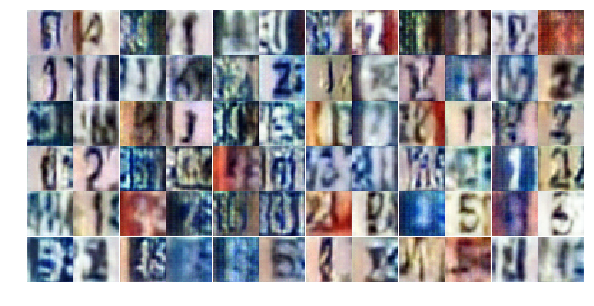

Epoch 7/25... Discriminator Loss: 0.5867... Generator Loss: 1.4054
Epoch 8/25... Discriminator Loss: 0.4915... Generator Loss: 1.4172
Epoch 8/25... Discriminator Loss: 0.9286... Generator Loss: 0.6849
Epoch 8/25... Discriminator Loss: 0.5812... Generator Loss: 1.1464
Epoch 8/25... Discriminator Loss: 0.7706... Generator Loss: 0.7859
Epoch 8/25... Discriminator Loss: 0.7261... Generator Loss: 1.0104
Epoch 8/25... Discriminator Loss: 1.1074... Generator Loss: 0.5649
Epoch 8/25... Discriminator Loss: 0.4631... Generator Loss: 1.9543
Epoch 8/25... Discriminator Loss: 0.9198... Generator Loss: 0.8525
Epoch 8/25... Discriminator Loss: 0.5108... Generator Loss: 1.3620


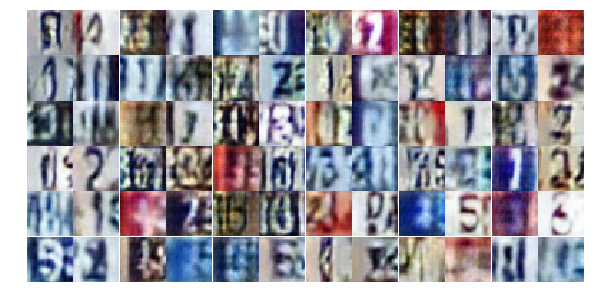

Epoch 8/25... Discriminator Loss: 0.5375... Generator Loss: 1.5396
Epoch 8/25... Discriminator Loss: 0.4802... Generator Loss: 1.9050
Epoch 8/25... Discriminator Loss: 0.5984... Generator Loss: 1.4539
Epoch 8/25... Discriminator Loss: 0.4015... Generator Loss: 2.4348
Epoch 8/25... Discriminator Loss: 0.8135... Generator Loss: 1.0808
Epoch 8/25... Discriminator Loss: 0.4300... Generator Loss: 1.8212
Epoch 8/25... Discriminator Loss: 0.4078... Generator Loss: 1.9539
Epoch 8/25... Discriminator Loss: 0.7382... Generator Loss: 0.9934
Epoch 8/25... Discriminator Loss: 0.3687... Generator Loss: 2.1651
Epoch 8/25... Discriminator Loss: 1.0534... Generator Loss: 1.0192


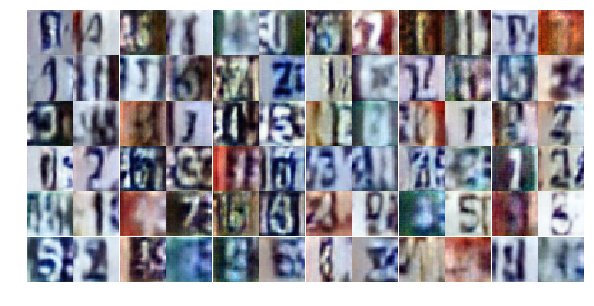

Epoch 8/25... Discriminator Loss: 0.3706... Generator Loss: 1.7677
Epoch 8/25... Discriminator Loss: 0.4729... Generator Loss: 1.3381
Epoch 8/25... Discriminator Loss: 1.1683... Generator Loss: 3.6362
Epoch 8/25... Discriminator Loss: 1.0685... Generator Loss: 3.4571
Epoch 8/25... Discriminator Loss: 0.5592... Generator Loss: 2.0170
Epoch 8/25... Discriminator Loss: 0.5861... Generator Loss: 1.6591
Epoch 8/25... Discriminator Loss: 0.9732... Generator Loss: 2.4034
Epoch 8/25... Discriminator Loss: 0.5785... Generator Loss: 1.0644
Epoch 8/25... Discriminator Loss: 0.6696... Generator Loss: 1.7341
Epoch 8/25... Discriminator Loss: 0.7374... Generator Loss: 0.9128


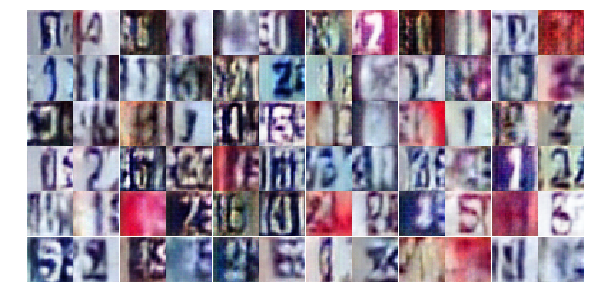

Epoch 8/25... Discriminator Loss: 0.5260... Generator Loss: 1.4035
Epoch 8/25... Discriminator Loss: 0.9100... Generator Loss: 0.7284
Epoch 8/25... Discriminator Loss: 0.4922... Generator Loss: 1.8026
Epoch 8/25... Discriminator Loss: 1.0991... Generator Loss: 0.5608
Epoch 8/25... Discriminator Loss: 0.8709... Generator Loss: 0.7127
Epoch 8/25... Discriminator Loss: 0.5089... Generator Loss: 1.4011
Epoch 8/25... Discriminator Loss: 0.4397... Generator Loss: 2.1130
Epoch 8/25... Discriminator Loss: 0.5876... Generator Loss: 1.2008
Epoch 8/25... Discriminator Loss: 2.0767... Generator Loss: 0.2920
Epoch 8/25... Discriminator Loss: 1.0592... Generator Loss: 0.6109


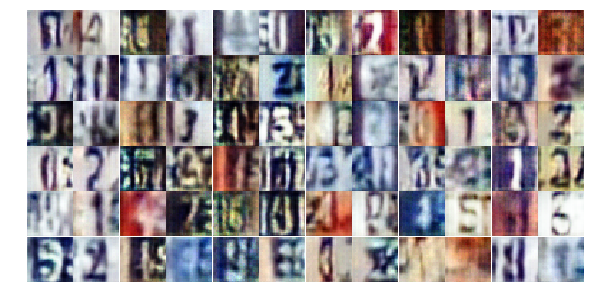

Epoch 8/25... Discriminator Loss: 0.7206... Generator Loss: 2.4764
Epoch 8/25... Discriminator Loss: 1.1274... Generator Loss: 0.6554
Epoch 8/25... Discriminator Loss: 0.4316... Generator Loss: 1.3998
Epoch 8/25... Discriminator Loss: 0.6201... Generator Loss: 1.1755
Epoch 8/25... Discriminator Loss: 0.9329... Generator Loss: 2.4429
Epoch 8/25... Discriminator Loss: 0.9561... Generator Loss: 0.6880
Epoch 8/25... Discriminator Loss: 0.2900... Generator Loss: 1.9812
Epoch 8/25... Discriminator Loss: 0.6624... Generator Loss: 1.2690
Epoch 8/25... Discriminator Loss: 0.6371... Generator Loss: 1.2739
Epoch 8/25... Discriminator Loss: 0.7419... Generator Loss: 1.0653


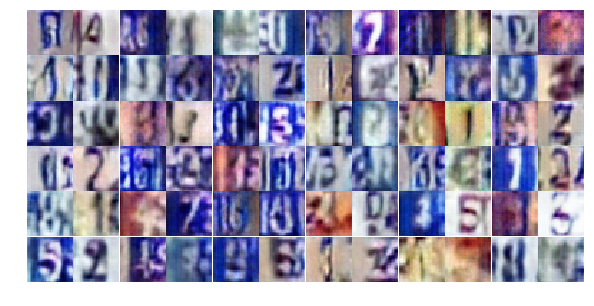

Epoch 8/25... Discriminator Loss: 0.5741... Generator Loss: 1.2644
Epoch 8/25... Discriminator Loss: 0.4701... Generator Loss: 1.6194
Epoch 8/25... Discriminator Loss: 0.4950... Generator Loss: 1.9532
Epoch 8/25... Discriminator Loss: 0.7506... Generator Loss: 0.9183
Epoch 8/25... Discriminator Loss: 0.9476... Generator Loss: 4.3597
Epoch 8/25... Discriminator Loss: 1.6685... Generator Loss: 0.3150
Epoch 8/25... Discriminator Loss: 0.5466... Generator Loss: 1.3638
Epoch 8/25... Discriminator Loss: 0.5561... Generator Loss: 2.0822
Epoch 9/25... Discriminator Loss: 0.7817... Generator Loss: 1.1477
Epoch 9/25... Discriminator Loss: 1.0129... Generator Loss: 0.6052


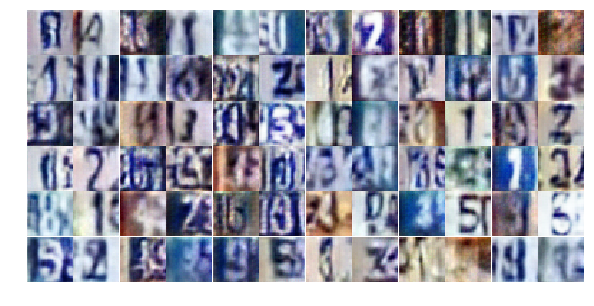

Epoch 9/25... Discriminator Loss: 0.6538... Generator Loss: 1.0401
Epoch 9/25... Discriminator Loss: 0.7378... Generator Loss: 0.9213
Epoch 9/25... Discriminator Loss: 0.6320... Generator Loss: 1.1675
Epoch 9/25... Discriminator Loss: 0.3584... Generator Loss: 1.8613
Epoch 9/25... Discriminator Loss: 1.0200... Generator Loss: 0.6627
Epoch 9/25... Discriminator Loss: 0.7451... Generator Loss: 3.0051
Epoch 9/25... Discriminator Loss: 0.5210... Generator Loss: 1.4780
Epoch 9/25... Discriminator Loss: 0.5004... Generator Loss: 1.2879
Epoch 9/25... Discriminator Loss: 1.1656... Generator Loss: 0.5140
Epoch 9/25... Discriminator Loss: 0.5953... Generator Loss: 1.6013


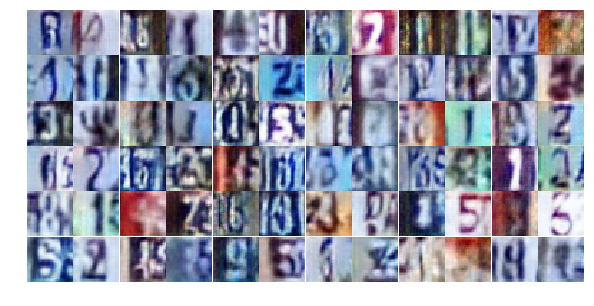

Epoch 9/25... Discriminator Loss: 0.7982... Generator Loss: 0.9748
Epoch 9/25... Discriminator Loss: 1.5675... Generator Loss: 0.3668
Epoch 9/25... Discriminator Loss: 0.6704... Generator Loss: 1.1351
Epoch 9/25... Discriminator Loss: 0.7011... Generator Loss: 1.0137
Epoch 9/25... Discriminator Loss: 0.6794... Generator Loss: 1.1452
Epoch 9/25... Discriminator Loss: 0.5085... Generator Loss: 1.5119
Epoch 9/25... Discriminator Loss: 0.7207... Generator Loss: 0.9298
Epoch 9/25... Discriminator Loss: 0.4185... Generator Loss: 1.4973
Epoch 9/25... Discriminator Loss: 0.8666... Generator Loss: 0.7727
Epoch 9/25... Discriminator Loss: 0.5720... Generator Loss: 2.2978


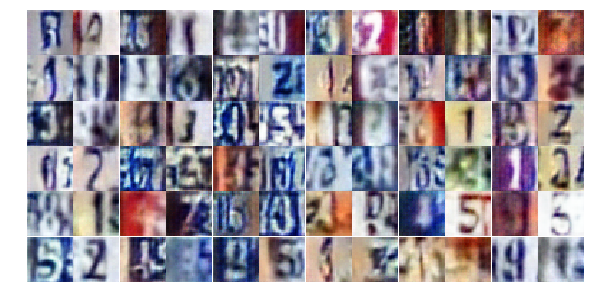

Epoch 9/25... Discriminator Loss: 1.7410... Generator Loss: 0.3211
Epoch 9/25... Discriminator Loss: 0.8311... Generator Loss: 0.9443
Epoch 9/25... Discriminator Loss: 0.5664... Generator Loss: 1.5330
Epoch 9/25... Discriminator Loss: 0.4624... Generator Loss: 1.9070
Epoch 9/25... Discriminator Loss: 0.5627... Generator Loss: 1.5335
Epoch 9/25... Discriminator Loss: 0.4885... Generator Loss: 1.4771
Epoch 9/25... Discriminator Loss: 1.1638... Generator Loss: 0.5078
Epoch 9/25... Discriminator Loss: 0.6040... Generator Loss: 1.3031
Epoch 9/25... Discriminator Loss: 0.5307... Generator Loss: 1.1535
Epoch 9/25... Discriminator Loss: 0.5989... Generator Loss: 1.1819


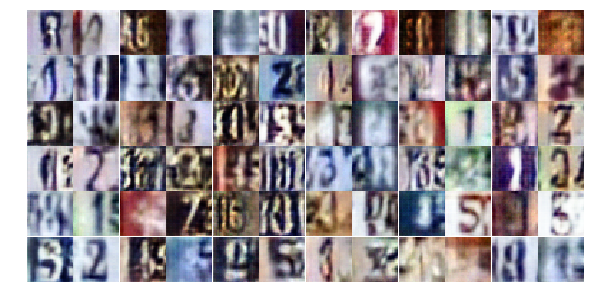

Epoch 9/25... Discriminator Loss: 0.5894... Generator Loss: 1.1024
Epoch 9/25... Discriminator Loss: 0.4476... Generator Loss: 1.7686
Epoch 9/25... Discriminator Loss: 0.7509... Generator Loss: 0.8046
Epoch 9/25... Discriminator Loss: 1.2568... Generator Loss: 0.4586
Epoch 9/25... Discriminator Loss: 0.6060... Generator Loss: 1.2186
Epoch 9/25... Discriminator Loss: 0.6845... Generator Loss: 0.9449
Epoch 9/25... Discriminator Loss: 0.9958... Generator Loss: 2.6929
Epoch 9/25... Discriminator Loss: 0.4686... Generator Loss: 2.3350
Epoch 9/25... Discriminator Loss: 1.5725... Generator Loss: 0.3566
Epoch 9/25... Discriminator Loss: 0.9393... Generator Loss: 0.6836


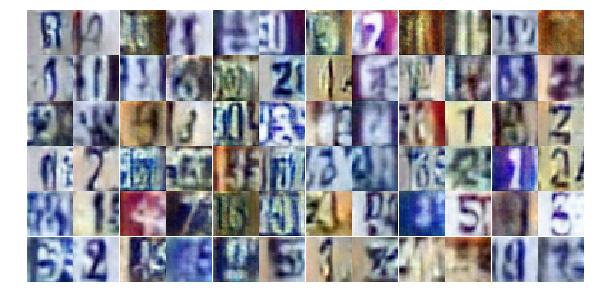

Epoch 9/25... Discriminator Loss: 0.4378... Generator Loss: 2.0724
Epoch 9/25... Discriminator Loss: 0.5140... Generator Loss: 1.3141
Epoch 9/25... Discriminator Loss: 0.4727... Generator Loss: 1.9294
Epoch 9/25... Discriminator Loss: 0.6327... Generator Loss: 2.1523
Epoch 9/25... Discriminator Loss: 0.7147... Generator Loss: 2.7778
Epoch 9/25... Discriminator Loss: 0.8624... Generator Loss: 0.7669
Epoch 9/25... Discriminator Loss: 0.8181... Generator Loss: 0.9167
Epoch 9/25... Discriminator Loss: 0.7220... Generator Loss: 0.9106
Epoch 9/25... Discriminator Loss: 0.7453... Generator Loss: 0.9414
Epoch 9/25... Discriminator Loss: 0.6490... Generator Loss: 2.3007


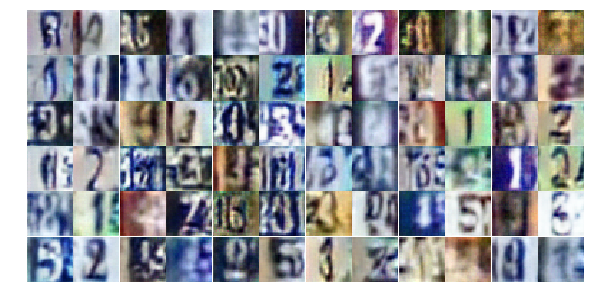

Epoch 9/25... Discriminator Loss: 0.9986... Generator Loss: 0.6491
Epoch 9/25... Discriminator Loss: 0.7325... Generator Loss: 2.2181
Epoch 9/25... Discriminator Loss: 0.5558... Generator Loss: 1.2452
Epoch 9/25... Discriminator Loss: 2.0107... Generator Loss: 0.2058
Epoch 9/25... Discriminator Loss: 0.8185... Generator Loss: 0.9143
Epoch 10/25... Discriminator Loss: 0.5688... Generator Loss: 1.3755
Epoch 10/25... Discriminator Loss: 0.5758... Generator Loss: 1.2802
Epoch 10/25... Discriminator Loss: 1.0692... Generator Loss: 0.5535
Epoch 10/25... Discriminator Loss: 0.7615... Generator Loss: 0.9410
Epoch 10/25... Discriminator Loss: 0.8587... Generator Loss: 0.6999


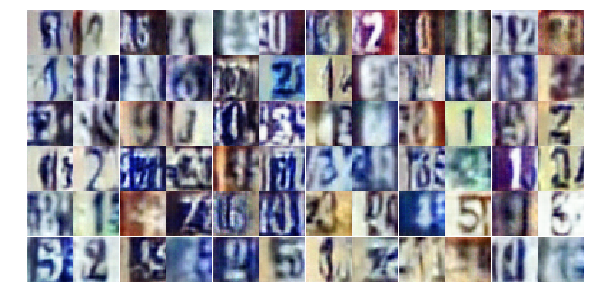

Epoch 10/25... Discriminator Loss: 1.4429... Generator Loss: 0.3870
Epoch 10/25... Discriminator Loss: 0.4886... Generator Loss: 1.3611
Epoch 10/25... Discriminator Loss: 0.6066... Generator Loss: 1.0831
Epoch 10/25... Discriminator Loss: 0.5424... Generator Loss: 1.2874
Epoch 10/25... Discriminator Loss: 0.5211... Generator Loss: 1.8153
Epoch 10/25... Discriminator Loss: 0.5502... Generator Loss: 1.3818
Epoch 10/25... Discriminator Loss: 0.6782... Generator Loss: 1.3068
Epoch 10/25... Discriminator Loss: 1.0274... Generator Loss: 0.6643
Epoch 10/25... Discriminator Loss: 0.9601... Generator Loss: 0.7780
Epoch 10/25... Discriminator Loss: 0.4135... Generator Loss: 1.7866


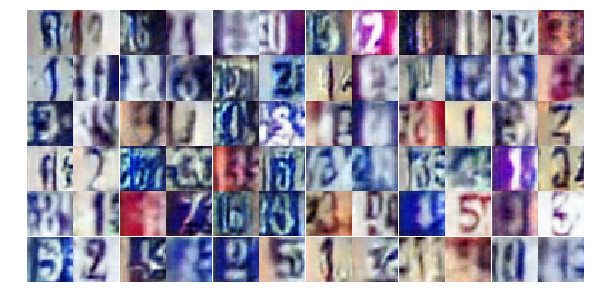

Epoch 10/25... Discriminator Loss: 0.5477... Generator Loss: 1.9641
Epoch 10/25... Discriminator Loss: 1.1512... Generator Loss: 0.5414
Epoch 10/25... Discriminator Loss: 1.3232... Generator Loss: 0.4650
Epoch 10/25... Discriminator Loss: 1.2789... Generator Loss: 0.4623
Epoch 10/25... Discriminator Loss: 0.6255... Generator Loss: 1.1515
Epoch 10/25... Discriminator Loss: 0.5252... Generator Loss: 1.4444
Epoch 10/25... Discriminator Loss: 0.5223... Generator Loss: 1.4755
Epoch 10/25... Discriminator Loss: 0.4456... Generator Loss: 1.7517
Epoch 10/25... Discriminator Loss: 0.9810... Generator Loss: 0.8161
Epoch 10/25... Discriminator Loss: 0.4006... Generator Loss: 2.6328


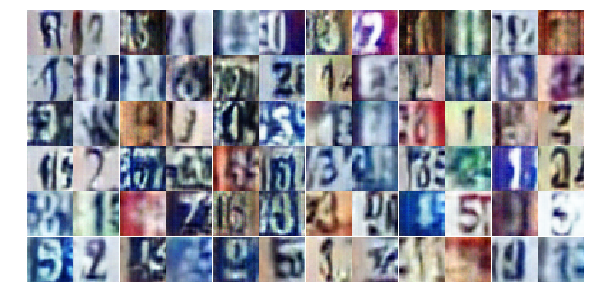

Epoch 10/25... Discriminator Loss: 1.3102... Generator Loss: 0.4304
Epoch 10/25... Discriminator Loss: 0.8306... Generator Loss: 0.9723
Epoch 10/25... Discriminator Loss: 0.4128... Generator Loss: 1.4881
Epoch 10/25... Discriminator Loss: 0.3680... Generator Loss: 2.5065
Epoch 10/25... Discriminator Loss: 1.1654... Generator Loss: 0.5142
Epoch 10/25... Discriminator Loss: 0.6531... Generator Loss: 1.0010
Epoch 10/25... Discriminator Loss: 0.2485... Generator Loss: 2.1779
Epoch 10/25... Discriminator Loss: 0.6637... Generator Loss: 1.2326
Epoch 10/25... Discriminator Loss: 0.6511... Generator Loss: 0.9687
Epoch 10/25... Discriminator Loss: 1.1085... Generator Loss: 2.5042


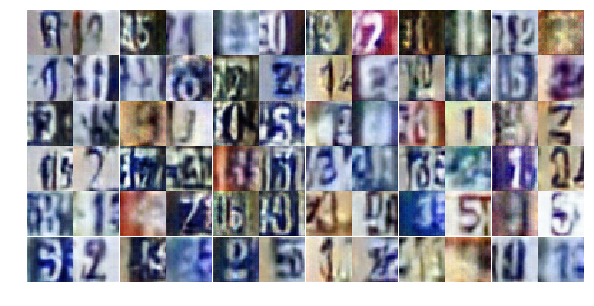

Epoch 10/25... Discriminator Loss: 0.5431... Generator Loss: 1.5466
Epoch 10/25... Discriminator Loss: 0.7657... Generator Loss: 0.9118
Epoch 10/25... Discriminator Loss: 0.6276... Generator Loss: 1.9622
Epoch 10/25... Discriminator Loss: 0.3949... Generator Loss: 1.6731
Epoch 10/25... Discriminator Loss: 0.6518... Generator Loss: 1.0341
Epoch 10/25... Discriminator Loss: 0.6852... Generator Loss: 0.9723
Epoch 10/25... Discriminator Loss: 0.8652... Generator Loss: 0.7754
Epoch 10/25... Discriminator Loss: 0.8552... Generator Loss: 0.7984
Epoch 10/25... Discriminator Loss: 0.9084... Generator Loss: 0.6861
Epoch 10/25... Discriminator Loss: 1.0825... Generator Loss: 0.6621


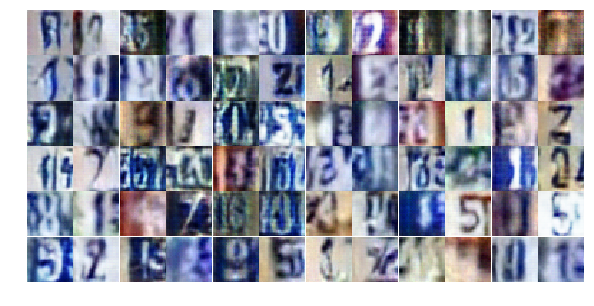

Epoch 10/25... Discriminator Loss: 1.1784... Generator Loss: 0.6324
Epoch 10/25... Discriminator Loss: 0.6227... Generator Loss: 1.6867
Epoch 10/25... Discriminator Loss: 0.4934... Generator Loss: 1.6529
Epoch 10/25... Discriminator Loss: 0.6305... Generator Loss: 1.0824
Epoch 10/25... Discriminator Loss: 0.3837... Generator Loss: 1.6332
Epoch 10/25... Discriminator Loss: 0.6017... Generator Loss: 1.4658
Epoch 10/25... Discriminator Loss: 0.5402... Generator Loss: 1.2779
Epoch 10/25... Discriminator Loss: 0.6394... Generator Loss: 1.0351
Epoch 10/25... Discriminator Loss: 0.6287... Generator Loss: 2.5883
Epoch 10/25... Discriminator Loss: 0.5822... Generator Loss: 1.5882


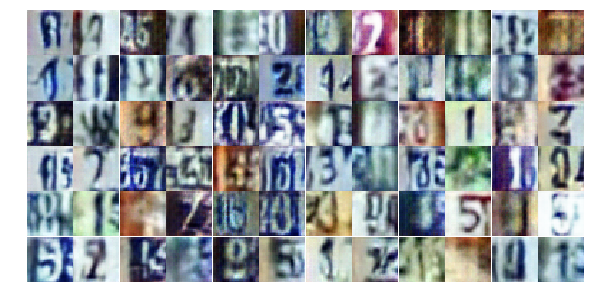

Epoch 10/25... Discriminator Loss: 0.7093... Generator Loss: 1.1469
Epoch 10/25... Discriminator Loss: 0.4565... Generator Loss: 1.7072
Epoch 10/25... Discriminator Loss: 0.7166... Generator Loss: 0.9332
Epoch 11/25... Discriminator Loss: 0.6793... Generator Loss: 1.0839
Epoch 11/25... Discriminator Loss: 0.5520... Generator Loss: 1.8351
Epoch 11/25... Discriminator Loss: 1.4181... Generator Loss: 0.3768
Epoch 11/25... Discriminator Loss: 0.7149... Generator Loss: 0.9834
Epoch 11/25... Discriminator Loss: 1.5870... Generator Loss: 0.4124
Epoch 11/25... Discriminator Loss: 1.2388... Generator Loss: 1.0270
Epoch 11/25... Discriminator Loss: 0.6126... Generator Loss: 1.6193


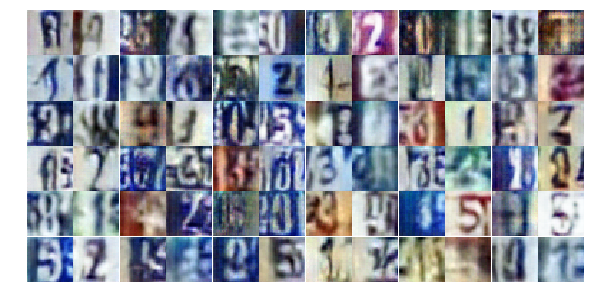

Epoch 11/25... Discriminator Loss: 0.4437... Generator Loss: 1.5348
Epoch 11/25... Discriminator Loss: 0.6211... Generator Loss: 1.1327
Epoch 11/25... Discriminator Loss: 0.2904... Generator Loss: 1.9695
Epoch 11/25... Discriminator Loss: 0.5641... Generator Loss: 1.1009
Epoch 11/25... Discriminator Loss: 0.5675... Generator Loss: 2.0013
Epoch 11/25... Discriminator Loss: 0.3571... Generator Loss: 1.9347
Epoch 11/25... Discriminator Loss: 0.6234... Generator Loss: 1.1576
Epoch 11/25... Discriminator Loss: 0.3219... Generator Loss: 2.4279
Epoch 11/25... Discriminator Loss: 0.6940... Generator Loss: 1.4201
Epoch 11/25... Discriminator Loss: 1.3483... Generator Loss: 0.4259


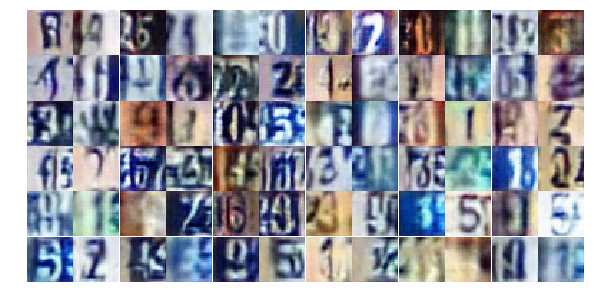

Epoch 11/25... Discriminator Loss: 0.7662... Generator Loss: 1.3742
Epoch 11/25... Discriminator Loss: 0.3727... Generator Loss: 1.7183
Epoch 11/25... Discriminator Loss: 1.2273... Generator Loss: 0.5495
Epoch 11/25... Discriminator Loss: 0.7035... Generator Loss: 0.9494
Epoch 11/25... Discriminator Loss: 0.3818... Generator Loss: 1.7929
Epoch 11/25... Discriminator Loss: 0.4691... Generator Loss: 1.7524
Epoch 11/25... Discriminator Loss: 0.3966... Generator Loss: 1.6147
Epoch 11/25... Discriminator Loss: 1.0225... Generator Loss: 0.7226
Epoch 11/25... Discriminator Loss: 0.5711... Generator Loss: 1.1852
Epoch 11/25... Discriminator Loss: 0.7635... Generator Loss: 0.9103


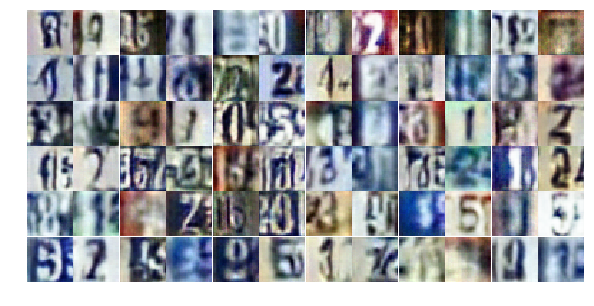

Epoch 11/25... Discriminator Loss: 0.6114... Generator Loss: 1.4999
Epoch 11/25... Discriminator Loss: 0.4999... Generator Loss: 1.4794
Epoch 11/25... Discriminator Loss: 0.7016... Generator Loss: 1.0687
Epoch 11/25... Discriminator Loss: 0.3498... Generator Loss: 1.5432
Epoch 11/25... Discriminator Loss: 0.5487... Generator Loss: 1.3095
Epoch 11/25... Discriminator Loss: 1.1611... Generator Loss: 0.5227
Epoch 11/25... Discriminator Loss: 0.8069... Generator Loss: 2.6060
Epoch 11/25... Discriminator Loss: 1.8773... Generator Loss: 0.8238
Epoch 11/25... Discriminator Loss: 1.0447... Generator Loss: 1.6665
Epoch 11/25... Discriminator Loss: 0.7650... Generator Loss: 1.2493


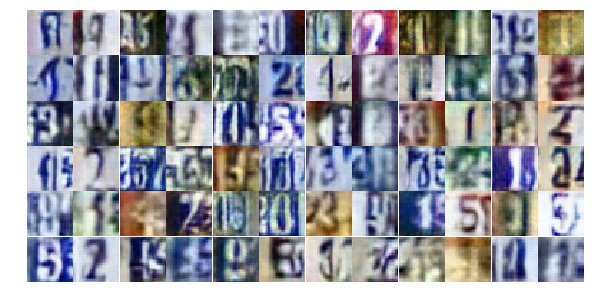

Epoch 11/25... Discriminator Loss: 0.7123... Generator Loss: 1.2312
Epoch 11/25... Discriminator Loss: 0.5809... Generator Loss: 1.2898
Epoch 11/25... Discriminator Loss: 0.8817... Generator Loss: 0.7320
Epoch 11/25... Discriminator Loss: 0.7534... Generator Loss: 0.9262
Epoch 11/25... Discriminator Loss: 0.9544... Generator Loss: 0.6686
Epoch 11/25... Discriminator Loss: 0.5433... Generator Loss: 1.3643
Epoch 11/25... Discriminator Loss: 0.3142... Generator Loss: 2.0143
Epoch 11/25... Discriminator Loss: 0.8010... Generator Loss: 0.9303
Epoch 11/25... Discriminator Loss: 1.0179... Generator Loss: 0.6656
Epoch 11/25... Discriminator Loss: 0.4966... Generator Loss: 1.1853


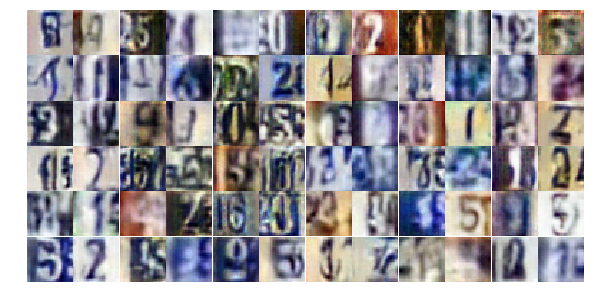

Epoch 11/25... Discriminator Loss: 0.8647... Generator Loss: 0.7229
Epoch 11/25... Discriminator Loss: 0.3886... Generator Loss: 1.8373
Epoch 11/25... Discriminator Loss: 0.7578... Generator Loss: 0.8953
Epoch 11/25... Discriminator Loss: 0.8476... Generator Loss: 0.7597
Epoch 11/25... Discriminator Loss: 1.5470... Generator Loss: 0.3440
Epoch 11/25... Discriminator Loss: 0.7964... Generator Loss: 1.0408
Epoch 11/25... Discriminator Loss: 0.9060... Generator Loss: 0.7628
Epoch 11/25... Discriminator Loss: 0.5250... Generator Loss: 1.8083
Epoch 11/25... Discriminator Loss: 0.6298... Generator Loss: 1.4358
Epoch 11/25... Discriminator Loss: 0.9110... Generator Loss: 0.7631


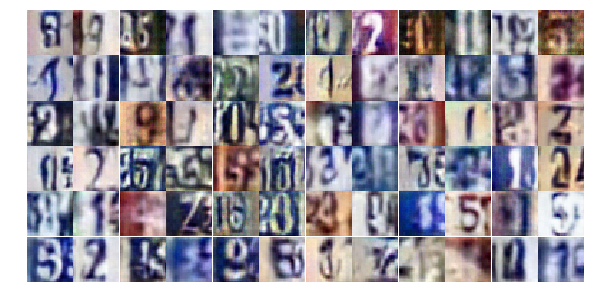

Epoch 12/25... Discriminator Loss: 0.8054... Generator Loss: 1.6121
Epoch 12/25... Discriminator Loss: 0.5941... Generator Loss: 1.1593
Epoch 12/25... Discriminator Loss: 0.8358... Generator Loss: 0.8272
Epoch 12/25... Discriminator Loss: 0.4121... Generator Loss: 1.7807
Epoch 12/25... Discriminator Loss: 0.4923... Generator Loss: 1.4643
Epoch 12/25... Discriminator Loss: 1.0918... Generator Loss: 0.5071
Epoch 12/25... Discriminator Loss: 0.6254... Generator Loss: 2.1697
Epoch 12/25... Discriminator Loss: 0.5931... Generator Loss: 1.8442
Epoch 12/25... Discriminator Loss: 0.7246... Generator Loss: 1.2035
Epoch 12/25... Discriminator Loss: 0.9903... Generator Loss: 0.6725


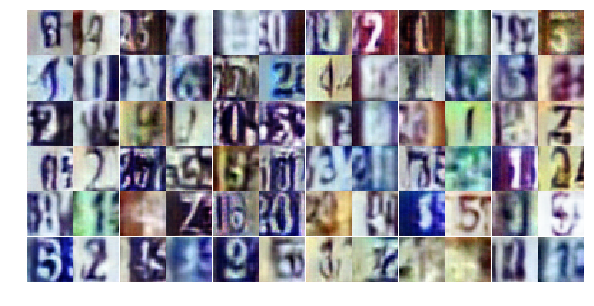

Epoch 12/25... Discriminator Loss: 0.4853... Generator Loss: 2.1873
Epoch 12/25... Discriminator Loss: 0.8593... Generator Loss: 0.8293
Epoch 12/25... Discriminator Loss: 0.5597... Generator Loss: 1.2271
Epoch 12/25... Discriminator Loss: 0.5533... Generator Loss: 1.4063
Epoch 12/25... Discriminator Loss: 0.4827... Generator Loss: 2.1723
Epoch 12/25... Discriminator Loss: 0.8745... Generator Loss: 0.8033
Epoch 12/25... Discriminator Loss: 1.7620... Generator Loss: 0.2616
Epoch 12/25... Discriminator Loss: 0.4484... Generator Loss: 2.6121
Epoch 12/25... Discriminator Loss: 0.7272... Generator Loss: 2.2142
Epoch 12/25... Discriminator Loss: 0.8499... Generator Loss: 0.8459


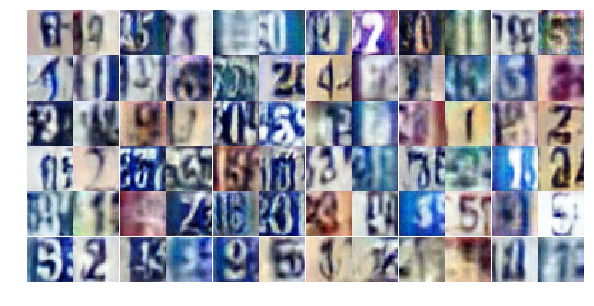

Epoch 12/25... Discriminator Loss: 0.4695... Generator Loss: 1.5689
Epoch 12/25... Discriminator Loss: 0.5242... Generator Loss: 1.2469
Epoch 12/25... Discriminator Loss: 0.7312... Generator Loss: 1.0882
Epoch 12/25... Discriminator Loss: 0.6409... Generator Loss: 1.5277
Epoch 12/25... Discriminator Loss: 0.3736... Generator Loss: 1.5426
Epoch 12/25... Discriminator Loss: 0.5331... Generator Loss: 1.2932
Epoch 12/25... Discriminator Loss: 0.5820... Generator Loss: 1.2611
Epoch 12/25... Discriminator Loss: 0.2863... Generator Loss: 1.9800
Epoch 12/25... Discriminator Loss: 0.5705... Generator Loss: 1.2617
Epoch 12/25... Discriminator Loss: 1.1119... Generator Loss: 0.5208


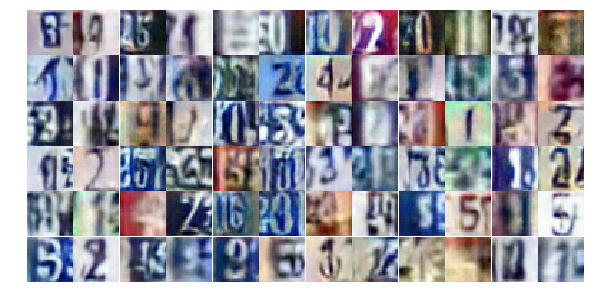

Epoch 12/25... Discriminator Loss: 0.4778... Generator Loss: 1.3866
Epoch 12/25... Discriminator Loss: 0.8012... Generator Loss: 0.9198
Epoch 12/25... Discriminator Loss: 0.7671... Generator Loss: 0.8888
Epoch 12/25... Discriminator Loss: 1.6978... Generator Loss: 0.2832
Epoch 12/25... Discriminator Loss: 0.6607... Generator Loss: 2.7274
Epoch 12/25... Discriminator Loss: 0.9863... Generator Loss: 0.7413
Epoch 12/25... Discriminator Loss: 0.9416... Generator Loss: 0.7380
Epoch 12/25... Discriminator Loss: 0.6170... Generator Loss: 1.3564
Epoch 12/25... Discriminator Loss: 1.5743... Generator Loss: 0.4637
Epoch 12/25... Discriminator Loss: 0.2724... Generator Loss: 2.1597


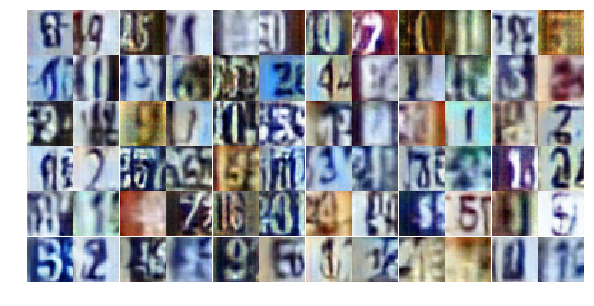

Epoch 12/25... Discriminator Loss: 0.7387... Generator Loss: 0.9651
Epoch 12/25... Discriminator Loss: 0.5418... Generator Loss: 2.7962
Epoch 12/25... Discriminator Loss: 0.4428... Generator Loss: 1.5385
Epoch 12/25... Discriminator Loss: 0.9098... Generator Loss: 0.7847
Epoch 12/25... Discriminator Loss: 0.7837... Generator Loss: 0.9401
Epoch 12/25... Discriminator Loss: 1.2132... Generator Loss: 0.4760
Epoch 12/25... Discriminator Loss: 0.6788... Generator Loss: 1.1570
Epoch 12/25... Discriminator Loss: 1.1716... Generator Loss: 0.5154
Epoch 12/25... Discriminator Loss: 0.6299... Generator Loss: 1.1318
Epoch 12/25... Discriminator Loss: 0.7326... Generator Loss: 0.9538


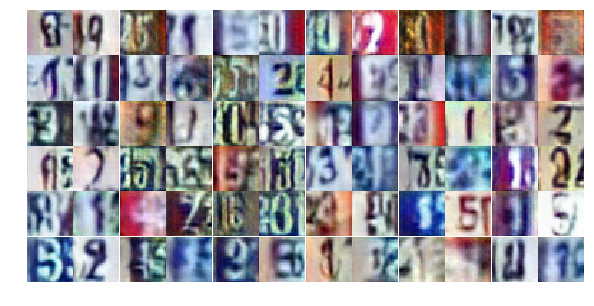

Epoch 12/25... Discriminator Loss: 0.9653... Generator Loss: 0.7382
Epoch 12/25... Discriminator Loss: 0.7466... Generator Loss: 0.9780
Epoch 12/25... Discriminator Loss: 0.6055... Generator Loss: 1.4721
Epoch 12/25... Discriminator Loss: 1.7665... Generator Loss: 0.2915
Epoch 12/25... Discriminator Loss: 0.6685... Generator Loss: 0.8962
Epoch 12/25... Discriminator Loss: 0.6551... Generator Loss: 1.1525
Epoch 12/25... Discriminator Loss: 1.1087... Generator Loss: 0.6291
Epoch 13/25... Discriminator Loss: 0.5752... Generator Loss: 1.1514
Epoch 13/25... Discriminator Loss: 0.3218... Generator Loss: 1.6994
Epoch 13/25... Discriminator Loss: 0.7519... Generator Loss: 0.9186


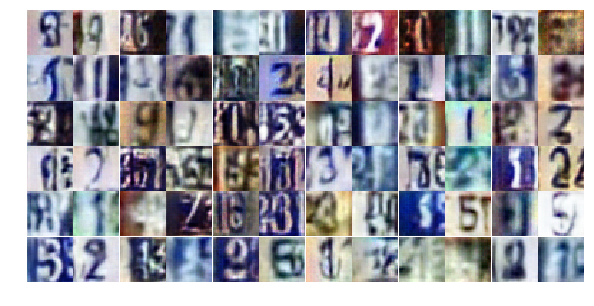

Epoch 13/25... Discriminator Loss: 0.5449... Generator Loss: 1.1926
Epoch 13/25... Discriminator Loss: 0.4945... Generator Loss: 1.4382
Epoch 13/25... Discriminator Loss: 1.6182... Generator Loss: 0.2940
Epoch 13/25... Discriminator Loss: 1.7581... Generator Loss: 0.2465
Epoch 13/25... Discriminator Loss: 0.5953... Generator Loss: 1.4172
Epoch 13/25... Discriminator Loss: 0.5808... Generator Loss: 1.2459
Epoch 13/25... Discriminator Loss: 0.4258... Generator Loss: 1.8089
Epoch 13/25... Discriminator Loss: 0.7088... Generator Loss: 0.9794
Epoch 13/25... Discriminator Loss: 0.3973... Generator Loss: 1.5210
Epoch 13/25... Discriminator Loss: 0.4996... Generator Loss: 1.4502


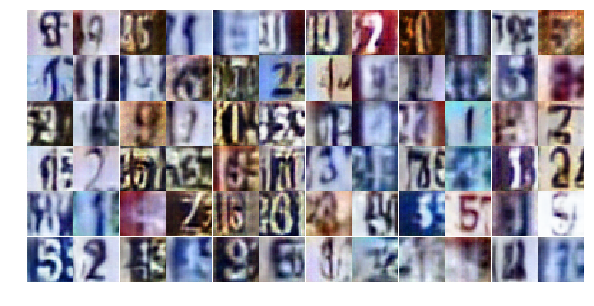

Epoch 13/25... Discriminator Loss: 0.6679... Generator Loss: 1.0451
Epoch 13/25... Discriminator Loss: 0.5509... Generator Loss: 1.2612
Epoch 13/25... Discriminator Loss: 3.3019... Generator Loss: 4.9539
Epoch 13/25... Discriminator Loss: 0.9248... Generator Loss: 1.5468
Epoch 13/25... Discriminator Loss: 0.6169... Generator Loss: 1.4869
Epoch 13/25... Discriminator Loss: 0.9668... Generator Loss: 0.7016
Epoch 13/25... Discriminator Loss: 0.8432... Generator Loss: 0.8395
Epoch 13/25... Discriminator Loss: 1.1322... Generator Loss: 0.5344
Epoch 13/25... Discriminator Loss: 0.8013... Generator Loss: 0.9487
Epoch 13/25... Discriminator Loss: 1.0387... Generator Loss: 0.6272


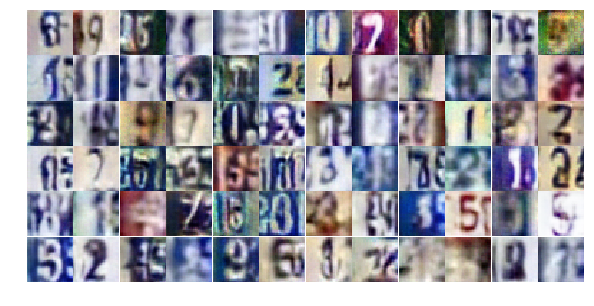

Epoch 13/25... Discriminator Loss: 0.6356... Generator Loss: 1.0433
Epoch 13/25... Discriminator Loss: 0.5743... Generator Loss: 1.3534
Epoch 13/25... Discriminator Loss: 0.4622... Generator Loss: 1.6545
Epoch 13/25... Discriminator Loss: 0.6091... Generator Loss: 1.1184
Epoch 13/25... Discriminator Loss: 0.7314... Generator Loss: 0.9314
Epoch 13/25... Discriminator Loss: 0.8779... Generator Loss: 0.7888
Epoch 13/25... Discriminator Loss: 0.8094... Generator Loss: 2.0058
Epoch 13/25... Discriminator Loss: 0.4895... Generator Loss: 1.3623
Epoch 13/25... Discriminator Loss: 0.4499... Generator Loss: 1.4510
Epoch 13/25... Discriminator Loss: 0.4982... Generator Loss: 1.5325


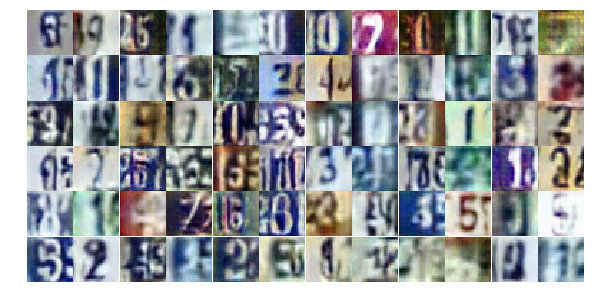

Epoch 13/25... Discriminator Loss: 1.1781... Generator Loss: 0.5352
Epoch 13/25... Discriminator Loss: 1.5283... Generator Loss: 0.3739
Epoch 13/25... Discriminator Loss: 0.6629... Generator Loss: 1.1933
Epoch 13/25... Discriminator Loss: 1.0674... Generator Loss: 0.6285
Epoch 13/25... Discriminator Loss: 0.4721... Generator Loss: 1.6297
Epoch 13/25... Discriminator Loss: 0.5011... Generator Loss: 1.4214
Epoch 13/25... Discriminator Loss: 0.5389... Generator Loss: 1.2507
Epoch 13/25... Discriminator Loss: 0.8587... Generator Loss: 0.9086
Epoch 13/25... Discriminator Loss: 0.5360... Generator Loss: 2.0222
Epoch 13/25... Discriminator Loss: 0.6195... Generator Loss: 1.1524


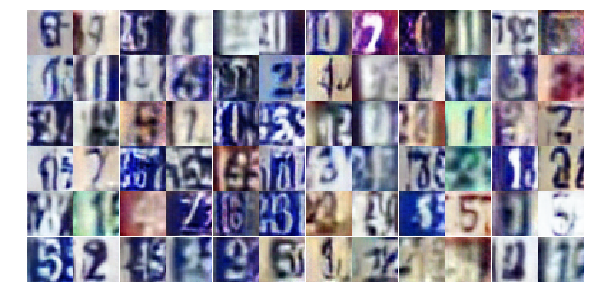

Epoch 13/25... Discriminator Loss: 0.4162... Generator Loss: 1.7110
Epoch 13/25... Discriminator Loss: 0.9822... Generator Loss: 0.6388
Epoch 13/25... Discriminator Loss: 0.6261... Generator Loss: 1.1453
Epoch 13/25... Discriminator Loss: 0.5121... Generator Loss: 1.5100
Epoch 13/25... Discriminator Loss: 1.3019... Generator Loss: 0.4530
Epoch 13/25... Discriminator Loss: 0.6615... Generator Loss: 1.6578
Epoch 13/25... Discriminator Loss: 1.0093... Generator Loss: 0.6338
Epoch 13/25... Discriminator Loss: 0.6889... Generator Loss: 0.9334
Epoch 13/25... Discriminator Loss: 0.9113... Generator Loss: 0.7222
Epoch 13/25... Discriminator Loss: 0.9979... Generator Loss: 0.6214


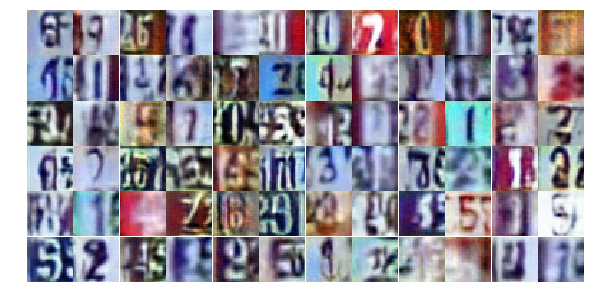

Epoch 13/25... Discriminator Loss: 0.3457... Generator Loss: 2.6489
Epoch 13/25... Discriminator Loss: 1.7647... Generator Loss: 0.2750
Epoch 13/25... Discriminator Loss: 0.9601... Generator Loss: 0.6529
Epoch 13/25... Discriminator Loss: 0.5243... Generator Loss: 1.2958
Epoch 14/25... Discriminator Loss: 0.9285... Generator Loss: 0.7102
Epoch 14/25... Discriminator Loss: 0.6164... Generator Loss: 1.0867
Epoch 14/25... Discriminator Loss: 0.7787... Generator Loss: 1.0721
Epoch 14/25... Discriminator Loss: 0.5981... Generator Loss: 1.5882
Epoch 14/25... Discriminator Loss: 0.6669... Generator Loss: 0.9698
Epoch 14/25... Discriminator Loss: 0.9808... Generator Loss: 0.6561


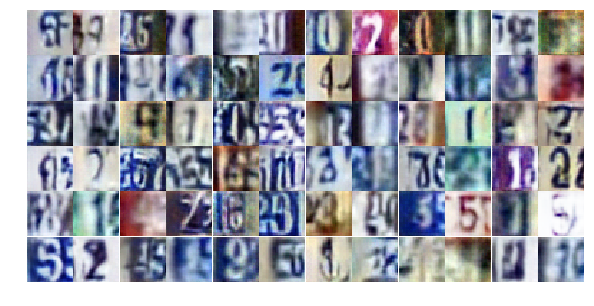

Epoch 14/25... Discriminator Loss: 0.7484... Generator Loss: 2.0020
Epoch 14/25... Discriminator Loss: 1.1515... Generator Loss: 0.5281
Epoch 14/25... Discriminator Loss: 0.4113... Generator Loss: 1.5923
Epoch 14/25... Discriminator Loss: 0.4893... Generator Loss: 1.5818
Epoch 14/25... Discriminator Loss: 1.0144... Generator Loss: 0.5990
Epoch 14/25... Discriminator Loss: 0.4324... Generator Loss: 1.2896
Epoch 14/25... Discriminator Loss: 0.2664... Generator Loss: 2.0220
Epoch 14/25... Discriminator Loss: 1.5874... Generator Loss: 0.3026
Epoch 14/25... Discriminator Loss: 1.4369... Generator Loss: 0.4440
Epoch 14/25... Discriminator Loss: 3.5549... Generator Loss: 0.0595


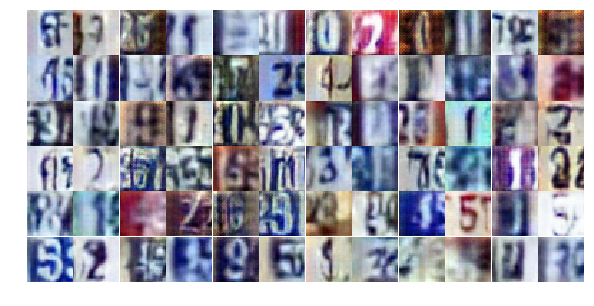

Epoch 14/25... Discriminator Loss: 0.4978... Generator Loss: 1.7903
Epoch 14/25... Discriminator Loss: 0.5425... Generator Loss: 1.6439
Epoch 14/25... Discriminator Loss: 1.0553... Generator Loss: 0.8238
Epoch 14/25... Discriminator Loss: 0.5149... Generator Loss: 1.3948
Epoch 14/25... Discriminator Loss: 0.8657... Generator Loss: 0.9989
Epoch 14/25... Discriminator Loss: 0.8952... Generator Loss: 0.8080
Epoch 14/25... Discriminator Loss: 0.5737... Generator Loss: 1.2106
Epoch 14/25... Discriminator Loss: 0.7350... Generator Loss: 1.0154
Epoch 14/25... Discriminator Loss: 0.7215... Generator Loss: 0.9216
Epoch 14/25... Discriminator Loss: 0.4264... Generator Loss: 1.5865


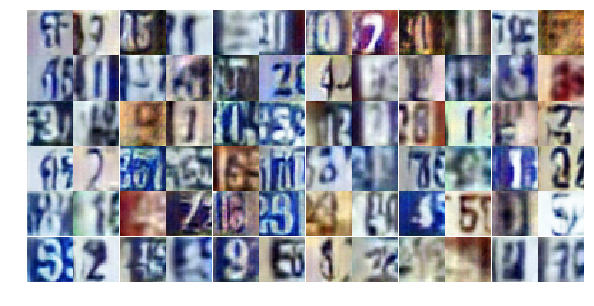

Epoch 14/25... Discriminator Loss: 1.5648... Generator Loss: 0.3556
Epoch 14/25... Discriminator Loss: 0.5283... Generator Loss: 1.1793
Epoch 14/25... Discriminator Loss: 0.5348... Generator Loss: 1.3072
Epoch 14/25... Discriminator Loss: 0.4998... Generator Loss: 1.3128
Epoch 14/25... Discriminator Loss: 0.5642... Generator Loss: 1.3053
Epoch 14/25... Discriminator Loss: 0.7773... Generator Loss: 0.8572
Epoch 14/25... Discriminator Loss: 0.5909... Generator Loss: 1.3741
Epoch 14/25... Discriminator Loss: 0.4578... Generator Loss: 1.5394
Epoch 14/25... Discriminator Loss: 0.3048... Generator Loss: 1.9012
Epoch 14/25... Discriminator Loss: 0.5915... Generator Loss: 1.9656


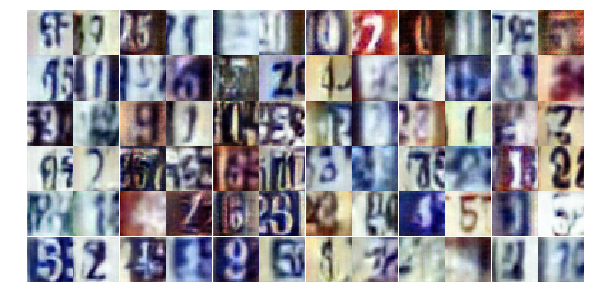

Epoch 14/25... Discriminator Loss: 1.1301... Generator Loss: 1.2673
Epoch 14/25... Discriminator Loss: 1.0204... Generator Loss: 0.9163
Epoch 14/25... Discriminator Loss: 0.9653... Generator Loss: 0.7159
Epoch 14/25... Discriminator Loss: 0.7287... Generator Loss: 1.0342
Epoch 14/25... Discriminator Loss: 0.6783... Generator Loss: 0.9260
Epoch 14/25... Discriminator Loss: 1.0263... Generator Loss: 0.6723
Epoch 14/25... Discriminator Loss: 0.8258... Generator Loss: 0.7970
Epoch 14/25... Discriminator Loss: 0.5816... Generator Loss: 1.1813
Epoch 14/25... Discriminator Loss: 0.9773... Generator Loss: 0.6359
Epoch 14/25... Discriminator Loss: 1.5173... Generator Loss: 0.3447


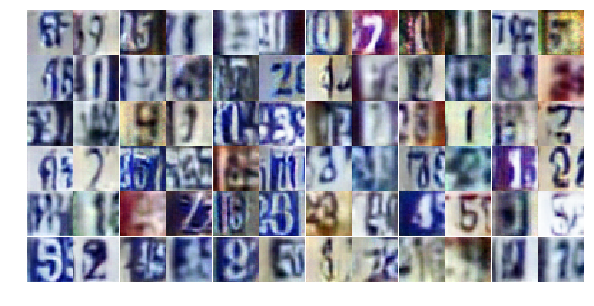

Epoch 14/25... Discriminator Loss: 1.0226... Generator Loss: 1.4047
Epoch 14/25... Discriminator Loss: 1.1224... Generator Loss: 0.5805
Epoch 14/25... Discriminator Loss: 0.5158... Generator Loss: 1.4335
Epoch 14/25... Discriminator Loss: 0.9676... Generator Loss: 0.6910
Epoch 14/25... Discriminator Loss: 0.5008... Generator Loss: 1.3753
Epoch 14/25... Discriminator Loss: 0.6547... Generator Loss: 1.1523
Epoch 14/25... Discriminator Loss: 0.8649... Generator Loss: 0.9339
Epoch 14/25... Discriminator Loss: 0.6951... Generator Loss: 1.2267
Epoch 14/25... Discriminator Loss: 1.0377... Generator Loss: 0.6347
Epoch 14/25... Discriminator Loss: 1.1118... Generator Loss: 0.5438


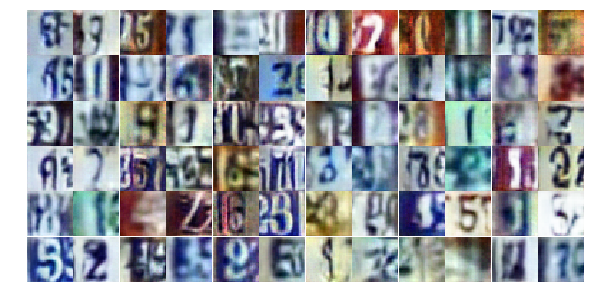

Epoch 14/25... Discriminator Loss: 0.7975... Generator Loss: 0.8890
Epoch 14/25... Discriminator Loss: 1.5471... Generator Loss: 0.3743
Epoch 15/25... Discriminator Loss: 0.7020... Generator Loss: 1.0074
Epoch 15/25... Discriminator Loss: 0.5299... Generator Loss: 1.6530
Epoch 15/25... Discriminator Loss: 0.6377... Generator Loss: 1.1703
Epoch 15/25... Discriminator Loss: 0.9360... Generator Loss: 0.7077
Epoch 15/25... Discriminator Loss: 0.9383... Generator Loss: 0.6749
Epoch 15/25... Discriminator Loss: 0.5536... Generator Loss: 2.1695
Epoch 15/25... Discriminator Loss: 1.0707... Generator Loss: 0.6437
Epoch 15/25... Discriminator Loss: 0.5695... Generator Loss: 1.1996


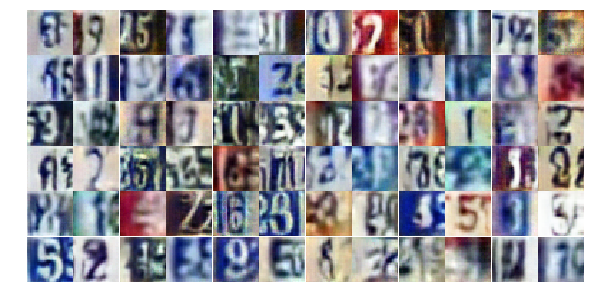

Epoch 15/25... Discriminator Loss: 0.8145... Generator Loss: 0.8575
Epoch 15/25... Discriminator Loss: 0.7015... Generator Loss: 1.0193
Epoch 15/25... Discriminator Loss: 0.9013... Generator Loss: 0.8018
Epoch 15/25... Discriminator Loss: 0.7785... Generator Loss: 0.8744
Epoch 15/25... Discriminator Loss: 0.7862... Generator Loss: 0.9278
Epoch 15/25... Discriminator Loss: 0.4916... Generator Loss: 1.4547
Epoch 15/25... Discriminator Loss: 0.8532... Generator Loss: 0.8862
Epoch 15/25... Discriminator Loss: 0.5230... Generator Loss: 1.4402
Epoch 15/25... Discriminator Loss: 0.6655... Generator Loss: 3.1557
Epoch 15/25... Discriminator Loss: 1.6774... Generator Loss: 0.3566


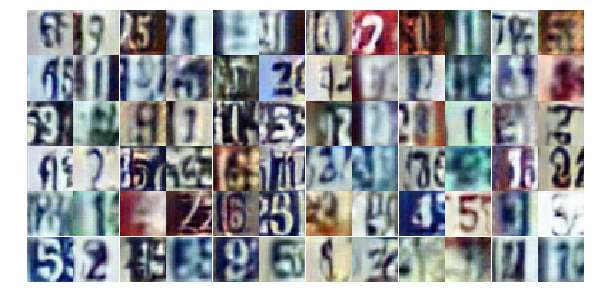

Epoch 15/25... Discriminator Loss: 1.0270... Generator Loss: 0.6458
Epoch 15/25... Discriminator Loss: 0.7150... Generator Loss: 0.9548
Epoch 15/25... Discriminator Loss: 0.6165... Generator Loss: 2.1565
Epoch 15/25... Discriminator Loss: 0.9151... Generator Loss: 0.7867
Epoch 15/25... Discriminator Loss: 0.7519... Generator Loss: 1.0164
Epoch 15/25... Discriminator Loss: 0.6713... Generator Loss: 1.1425
Epoch 15/25... Discriminator Loss: 0.7737... Generator Loss: 0.9052
Epoch 15/25... Discriminator Loss: 0.6890... Generator Loss: 0.9329
Epoch 15/25... Discriminator Loss: 0.4796... Generator Loss: 1.6977
Epoch 15/25... Discriminator Loss: 1.5255... Generator Loss: 0.3928


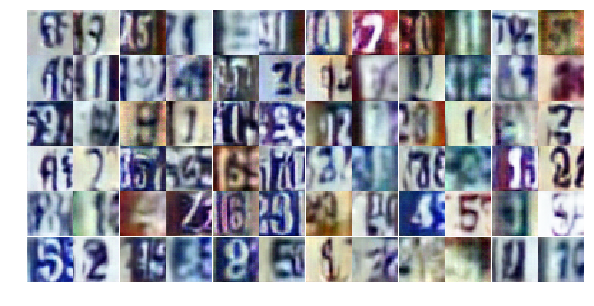

Epoch 15/25... Discriminator Loss: 0.6718... Generator Loss: 1.1159
Epoch 15/25... Discriminator Loss: 0.8072... Generator Loss: 0.8992
Epoch 15/25... Discriminator Loss: 0.4545... Generator Loss: 1.3151
Epoch 15/25... Discriminator Loss: 0.5249... Generator Loss: 1.4102
Epoch 15/25... Discriminator Loss: 0.5659... Generator Loss: 1.7781
Epoch 15/25... Discriminator Loss: 1.3854... Generator Loss: 2.9709
Epoch 15/25... Discriminator Loss: 0.5978... Generator Loss: 1.8112
Epoch 15/25... Discriminator Loss: 0.6718... Generator Loss: 1.2876
Epoch 15/25... Discriminator Loss: 0.6715... Generator Loss: 1.0563
Epoch 15/25... Discriminator Loss: 0.7717... Generator Loss: 1.1585


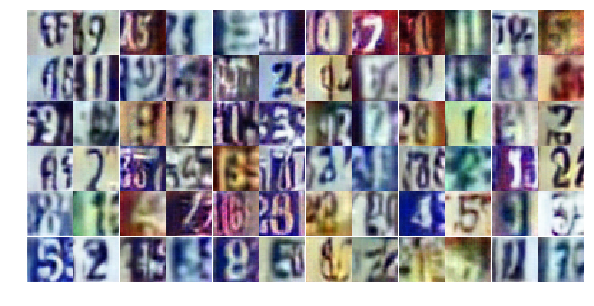

Epoch 15/25... Discriminator Loss: 0.5527... Generator Loss: 1.1646
Epoch 15/25... Discriminator Loss: 1.1235... Generator Loss: 0.5993
Epoch 15/25... Discriminator Loss: 0.9350... Generator Loss: 0.6768
Epoch 15/25... Discriminator Loss: 0.5877... Generator Loss: 1.1818
Epoch 15/25... Discriminator Loss: 0.5113... Generator Loss: 1.2543
Epoch 15/25... Discriminator Loss: 1.7605... Generator Loss: 0.3569
Epoch 15/25... Discriminator Loss: 0.5057... Generator Loss: 1.4728
Epoch 15/25... Discriminator Loss: 0.8062... Generator Loss: 1.5670
Epoch 15/25... Discriminator Loss: 0.7212... Generator Loss: 0.9426
Epoch 15/25... Discriminator Loss: 0.7895... Generator Loss: 0.9936


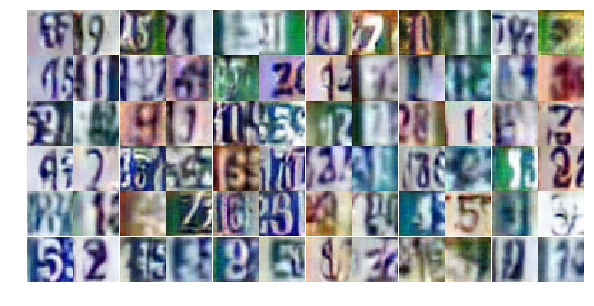

Epoch 15/25... Discriminator Loss: 0.9661... Generator Loss: 0.6978
Epoch 15/25... Discriminator Loss: 0.8038... Generator Loss: 0.9893
Epoch 15/25... Discriminator Loss: 0.4684... Generator Loss: 1.4019
Epoch 15/25... Discriminator Loss: 1.2599... Generator Loss: 0.4684
Epoch 15/25... Discriminator Loss: 0.7432... Generator Loss: 0.9975
Epoch 15/25... Discriminator Loss: 0.8118... Generator Loss: 1.5061
Epoch 15/25... Discriminator Loss: 0.9478... Generator Loss: 0.7385
Epoch 15/25... Discriminator Loss: 0.4944... Generator Loss: 1.8125
Epoch 15/25... Discriminator Loss: 1.4373... Generator Loss: 0.4133
Epoch 16/25... Discriminator Loss: 1.0090... Generator Loss: 0.6807


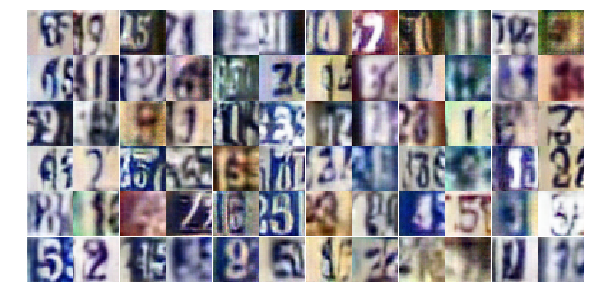

Epoch 16/25... Discriminator Loss: 0.5518... Generator Loss: 1.2398
Epoch 16/25... Discriminator Loss: 0.7729... Generator Loss: 0.9427
Epoch 16/25... Discriminator Loss: 0.9310... Generator Loss: 0.7316
Epoch 16/25... Discriminator Loss: 1.1823... Generator Loss: 0.5318
Epoch 16/25... Discriminator Loss: 0.6075... Generator Loss: 2.8549
Epoch 16/25... Discriminator Loss: 0.9729... Generator Loss: 3.2084
Epoch 16/25... Discriminator Loss: 2.1811... Generator Loss: 0.1999
Epoch 16/25... Discriminator Loss: 0.9980... Generator Loss: 0.7452
Epoch 16/25... Discriminator Loss: 0.5754... Generator Loss: 1.1685
Epoch 16/25... Discriminator Loss: 0.5450... Generator Loss: 1.2790


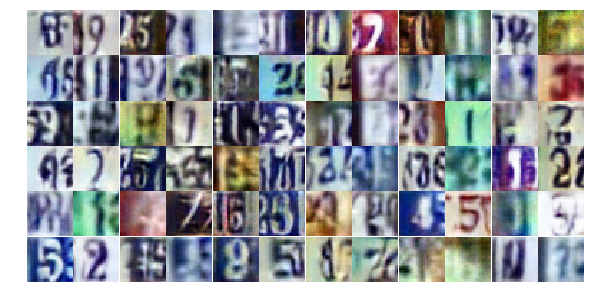

Epoch 16/25... Discriminator Loss: 1.0146... Generator Loss: 0.6710
Epoch 16/25... Discriminator Loss: 0.6744... Generator Loss: 1.0833
Epoch 16/25... Discriminator Loss: 0.7456... Generator Loss: 0.9735
Epoch 16/25... Discriminator Loss: 1.9254... Generator Loss: 0.2259
Epoch 16/25... Discriminator Loss: 0.6211... Generator Loss: 1.8997
Epoch 16/25... Discriminator Loss: 0.7437... Generator Loss: 1.2136
Epoch 16/25... Discriminator Loss: 0.9392... Generator Loss: 0.7583
Epoch 16/25... Discriminator Loss: 0.3855... Generator Loss: 1.7219
Epoch 16/25... Discriminator Loss: 0.4784... Generator Loss: 1.4449
Epoch 16/25... Discriminator Loss: 0.5094... Generator Loss: 1.3573


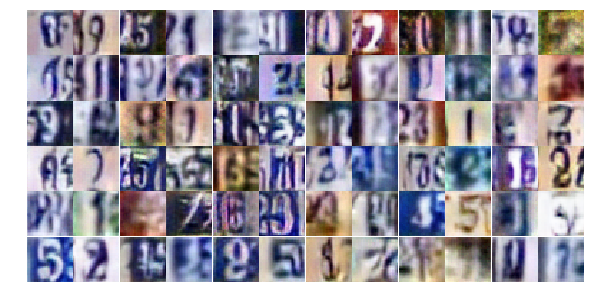

Epoch 16/25... Discriminator Loss: 0.5920... Generator Loss: 1.2589
Epoch 16/25... Discriminator Loss: 0.6658... Generator Loss: 1.4788
Epoch 16/25... Discriminator Loss: 0.8300... Generator Loss: 0.8640
Epoch 16/25... Discriminator Loss: 1.2709... Generator Loss: 0.5425
Epoch 16/25... Discriminator Loss: 0.7483... Generator Loss: 1.1561
Epoch 16/25... Discriminator Loss: 0.9419... Generator Loss: 0.6625
Epoch 16/25... Discriminator Loss: 0.6763... Generator Loss: 1.0701
Epoch 16/25... Discriminator Loss: 0.5376... Generator Loss: 1.3433
Epoch 16/25... Discriminator Loss: 1.5791... Generator Loss: 0.3707
Epoch 16/25... Discriminator Loss: 0.5857... Generator Loss: 1.3565


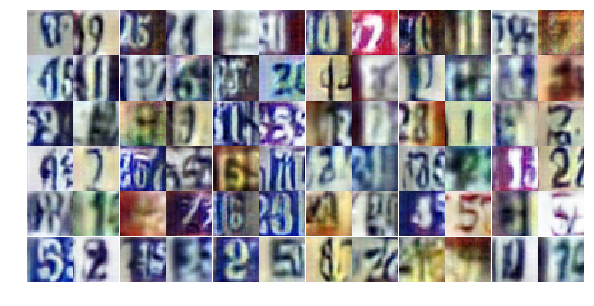

Epoch 16/25... Discriminator Loss: 0.6869... Generator Loss: 0.9933
Epoch 16/25... Discriminator Loss: 0.5479... Generator Loss: 1.2600
Epoch 16/25... Discriminator Loss: 0.8088... Generator Loss: 0.9316
Epoch 16/25... Discriminator Loss: 0.5756... Generator Loss: 1.5833
Epoch 16/25... Discriminator Loss: 1.1979... Generator Loss: 0.5014
Epoch 16/25... Discriminator Loss: 0.6748... Generator Loss: 1.3230
Epoch 16/25... Discriminator Loss: 0.9177... Generator Loss: 0.7599
Epoch 16/25... Discriminator Loss: 0.9195... Generator Loss: 0.7481
Epoch 16/25... Discriminator Loss: 0.7956... Generator Loss: 0.9454
Epoch 16/25... Discriminator Loss: 0.3881... Generator Loss: 1.6943


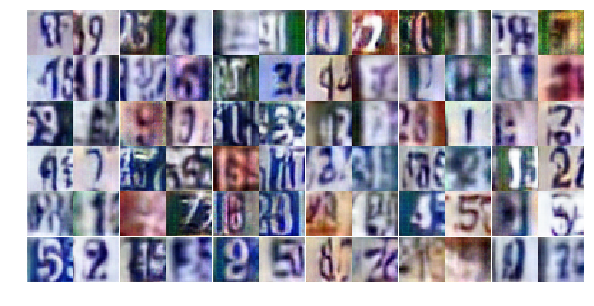

Epoch 16/25... Discriminator Loss: 0.5470... Generator Loss: 1.6153
Epoch 16/25... Discriminator Loss: 0.7758... Generator Loss: 0.8980
Epoch 16/25... Discriminator Loss: 1.3455... Generator Loss: 0.4422
Epoch 16/25... Discriminator Loss: 0.8413... Generator Loss: 1.2852
Epoch 16/25... Discriminator Loss: 0.9156... Generator Loss: 0.8036
Epoch 16/25... Discriminator Loss: 1.0710... Generator Loss: 0.6314
Epoch 16/25... Discriminator Loss: 0.5659... Generator Loss: 1.3277
Epoch 16/25... Discriminator Loss: 1.1827... Generator Loss: 0.5134
Epoch 16/25... Discriminator Loss: 0.7416... Generator Loss: 0.8858
Epoch 16/25... Discriminator Loss: 1.0420... Generator Loss: 0.6636


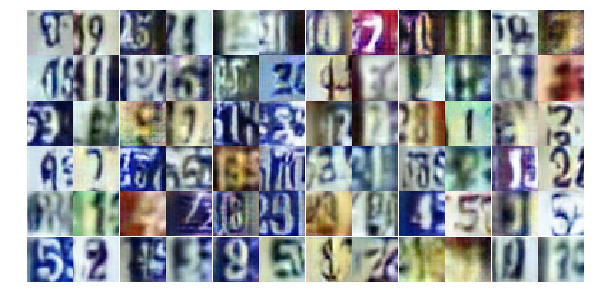

Epoch 16/25... Discriminator Loss: 1.1780... Generator Loss: 0.4834
Epoch 16/25... Discriminator Loss: 0.5806... Generator Loss: 1.5482
Epoch 16/25... Discriminator Loss: 1.2068... Generator Loss: 0.5108
Epoch 16/25... Discriminator Loss: 0.4888... Generator Loss: 2.4739
Epoch 16/25... Discriminator Loss: 1.9277... Generator Loss: 0.3983
Epoch 16/25... Discriminator Loss: 1.2950... Generator Loss: 0.4752
Epoch 17/25... Discriminator Loss: 0.6645... Generator Loss: 1.4660
Epoch 17/25... Discriminator Loss: 0.8910... Generator Loss: 0.8558
Epoch 17/25... Discriminator Loss: 0.6348... Generator Loss: 1.1034
Epoch 17/25... Discriminator Loss: 0.7353... Generator Loss: 1.0827


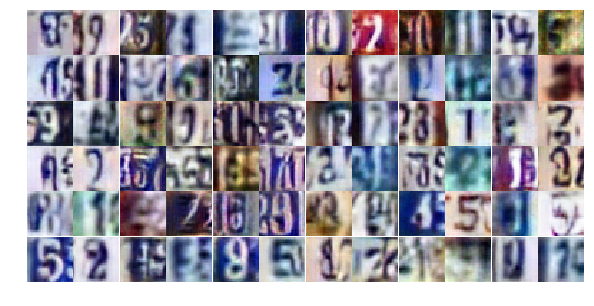

Epoch 17/25... Discriminator Loss: 0.4941... Generator Loss: 1.3661
Epoch 17/25... Discriminator Loss: 0.3484... Generator Loss: 1.6498
Epoch 17/25... Discriminator Loss: 0.8082... Generator Loss: 0.9303
Epoch 17/25... Discriminator Loss: 0.6165... Generator Loss: 1.0902
Epoch 17/25... Discriminator Loss: 1.0784... Generator Loss: 0.6376
Epoch 17/25... Discriminator Loss: 1.0931... Generator Loss: 0.6693
Epoch 17/25... Discriminator Loss: 0.8450... Generator Loss: 0.8082
Epoch 17/25... Discriminator Loss: 0.6786... Generator Loss: 1.0851
Epoch 17/25... Discriminator Loss: 0.3131... Generator Loss: 2.0178
Epoch 17/25... Discriminator Loss: 0.6081... Generator Loss: 1.5819


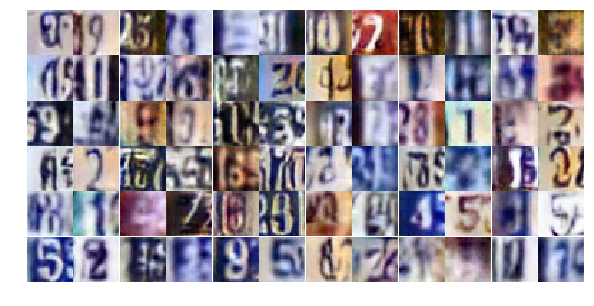

Epoch 17/25... Discriminator Loss: 0.8307... Generator Loss: 0.8804
Epoch 17/25... Discriminator Loss: 0.6640... Generator Loss: 2.3285
Epoch 17/25... Discriminator Loss: 0.6244... Generator Loss: 1.2533
Epoch 17/25... Discriminator Loss: 0.8635... Generator Loss: 0.9952
Epoch 17/25... Discriminator Loss: 0.5450... Generator Loss: 1.6312
Epoch 17/25... Discriminator Loss: 0.7893... Generator Loss: 0.8457
Epoch 17/25... Discriminator Loss: 0.6299... Generator Loss: 1.1346
Epoch 17/25... Discriminator Loss: 0.5020... Generator Loss: 1.5078
Epoch 17/25... Discriminator Loss: 0.4910... Generator Loss: 1.3507
Epoch 17/25... Discriminator Loss: 0.5717... Generator Loss: 1.2467


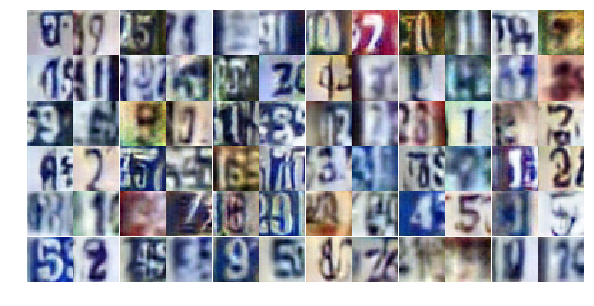

Epoch 17/25... Discriminator Loss: 1.7830... Generator Loss: 0.2592
Epoch 17/25... Discriminator Loss: 0.5077... Generator Loss: 1.5297
Epoch 17/25... Discriminator Loss: 0.5626... Generator Loss: 1.3174
Epoch 17/25... Discriminator Loss: 1.3957... Generator Loss: 0.4458
Epoch 17/25... Discriminator Loss: 1.7262... Generator Loss: 0.2850
Epoch 17/25... Discriminator Loss: 0.6138... Generator Loss: 1.1336
Epoch 17/25... Discriminator Loss: 0.6082... Generator Loss: 1.1334
Epoch 17/25... Discriminator Loss: 0.7696... Generator Loss: 0.9036
Epoch 17/25... Discriminator Loss: 1.0861... Generator Loss: 0.5807
Epoch 17/25... Discriminator Loss: 0.4153... Generator Loss: 1.7523


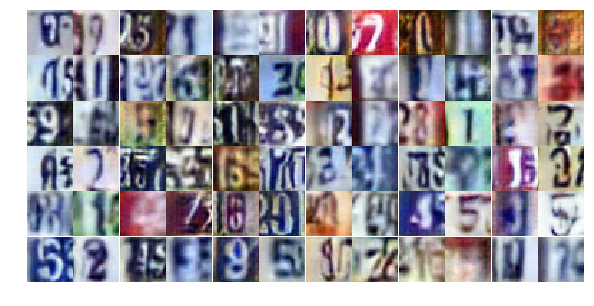

Epoch 17/25... Discriminator Loss: 1.7289... Generator Loss: 0.3210
Epoch 17/25... Discriminator Loss: 1.3910... Generator Loss: 0.4223
Epoch 17/25... Discriminator Loss: 0.7673... Generator Loss: 1.0743
Epoch 17/25... Discriminator Loss: 0.7562... Generator Loss: 1.8167
Epoch 17/25... Discriminator Loss: 0.8405... Generator Loss: 0.9280
Epoch 17/25... Discriminator Loss: 0.6933... Generator Loss: 0.9888
Epoch 17/25... Discriminator Loss: 0.7906... Generator Loss: 1.0436
Epoch 17/25... Discriminator Loss: 0.4605... Generator Loss: 1.5020
Epoch 17/25... Discriminator Loss: 0.3479... Generator Loss: 1.9619
Epoch 17/25... Discriminator Loss: 0.9526... Generator Loss: 0.6550


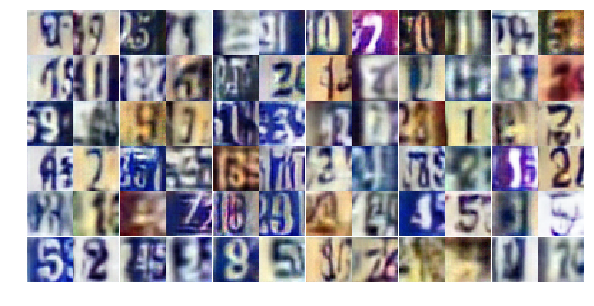

Epoch 17/25... Discriminator Loss: 0.9388... Generator Loss: 1.1353
Epoch 17/25... Discriminator Loss: 0.3921... Generator Loss: 2.7753
Epoch 17/25... Discriminator Loss: 0.7319... Generator Loss: 1.8105
Epoch 17/25... Discriminator Loss: 0.5019... Generator Loss: 1.3340
Epoch 17/25... Discriminator Loss: 0.9401... Generator Loss: 0.6925
Epoch 17/25... Discriminator Loss: 1.1205... Generator Loss: 0.5491
Epoch 17/25... Discriminator Loss: 1.0406... Generator Loss: 0.6295
Epoch 17/25... Discriminator Loss: 0.5383... Generator Loss: 1.2872
Epoch 17/25... Discriminator Loss: 0.8587... Generator Loss: 1.8750
Epoch 17/25... Discriminator Loss: 1.5360... Generator Loss: 0.3649


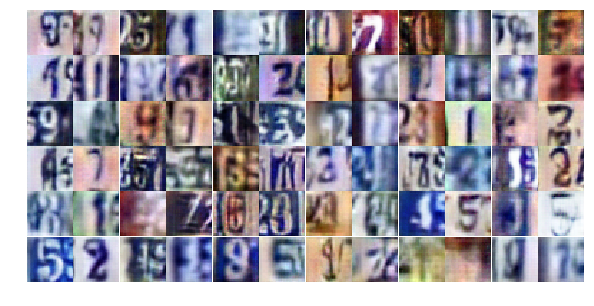

Epoch 17/25... Discriminator Loss: 0.9834... Generator Loss: 0.7261
Epoch 17/25... Discriminator Loss: 1.0342... Generator Loss: 0.6365
Epoch 17/25... Discriminator Loss: 0.5192... Generator Loss: 1.3993
Epoch 17/25... Discriminator Loss: 0.6994... Generator Loss: 1.0343
Epoch 18/25... Discriminator Loss: 0.9720... Generator Loss: 0.6550
Epoch 18/25... Discriminator Loss: 0.8863... Generator Loss: 0.7613
Epoch 18/25... Discriminator Loss: 0.7652... Generator Loss: 0.9069
Epoch 18/25... Discriminator Loss: 0.6725... Generator Loss: 0.9955
Epoch 18/25... Discriminator Loss: 0.9033... Generator Loss: 0.8024
Epoch 18/25... Discriminator Loss: 0.6283... Generator Loss: 1.3681


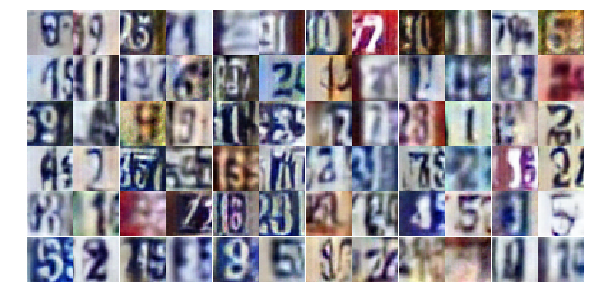

Epoch 18/25... Discriminator Loss: 0.4098... Generator Loss: 1.8443
Epoch 18/25... Discriminator Loss: 1.0882... Generator Loss: 0.6204
Epoch 18/25... Discriminator Loss: 1.0828... Generator Loss: 0.5539
Epoch 18/25... Discriminator Loss: 0.4424... Generator Loss: 1.5892
Epoch 18/25... Discriminator Loss: 0.7540... Generator Loss: 0.8272
Epoch 18/25... Discriminator Loss: 0.9679... Generator Loss: 0.7026
Epoch 18/25... Discriminator Loss: 0.6254... Generator Loss: 1.0112
Epoch 18/25... Discriminator Loss: 1.0316... Generator Loss: 0.6429
Epoch 18/25... Discriminator Loss: 0.6862... Generator Loss: 1.0178
Epoch 18/25... Discriminator Loss: 0.5784... Generator Loss: 1.2151


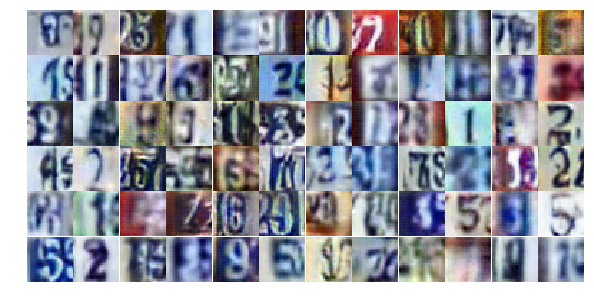

Epoch 18/25... Discriminator Loss: 1.4959... Generator Loss: 0.4692
Epoch 18/25... Discriminator Loss: 0.8356... Generator Loss: 0.8476
Epoch 18/25... Discriminator Loss: 0.7582... Generator Loss: 1.3837
Epoch 18/25... Discriminator Loss: 0.5235... Generator Loss: 1.2936
Epoch 18/25... Discriminator Loss: 0.6494... Generator Loss: 1.1054
Epoch 18/25... Discriminator Loss: 0.8611... Generator Loss: 1.0096
Epoch 18/25... Discriminator Loss: 0.9624... Generator Loss: 1.1125
Epoch 18/25... Discriminator Loss: 0.7824... Generator Loss: 0.8822
Epoch 18/25... Discriminator Loss: 0.5759... Generator Loss: 1.3138
Epoch 18/25... Discriminator Loss: 1.0832... Generator Loss: 3.2030


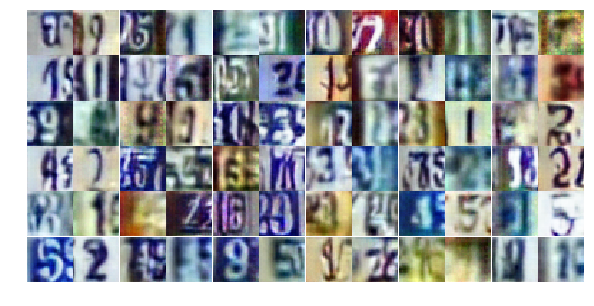

Epoch 18/25... Discriminator Loss: 3.4283... Generator Loss: 0.1117
Epoch 18/25... Discriminator Loss: 1.1408... Generator Loss: 0.6900
Epoch 18/25... Discriminator Loss: 0.6109... Generator Loss: 1.1390
Epoch 18/25... Discriminator Loss: 0.6740... Generator Loss: 1.0766
Epoch 18/25... Discriminator Loss: 0.8571... Generator Loss: 0.8356
Epoch 18/25... Discriminator Loss: 0.6883... Generator Loss: 1.1105
Epoch 18/25... Discriminator Loss: 0.7878... Generator Loss: 0.9291
Epoch 18/25... Discriminator Loss: 0.6105... Generator Loss: 1.7571
Epoch 18/25... Discriminator Loss: 0.5360... Generator Loss: 1.2102
Epoch 18/25... Discriminator Loss: 0.7915... Generator Loss: 0.8469


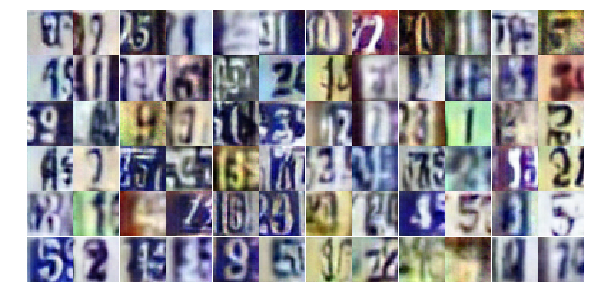

Epoch 18/25... Discriminator Loss: 0.6527... Generator Loss: 1.1941
Epoch 18/25... Discriminator Loss: 0.7123... Generator Loss: 1.0487
Epoch 18/25... Discriminator Loss: 0.7000... Generator Loss: 1.0427
Epoch 18/25... Discriminator Loss: 0.6495... Generator Loss: 1.0249
Epoch 18/25... Discriminator Loss: 0.7024... Generator Loss: 0.9666
Epoch 18/25... Discriminator Loss: 0.4357... Generator Loss: 1.4623
Epoch 18/25... Discriminator Loss: 0.8265... Generator Loss: 0.8225
Epoch 18/25... Discriminator Loss: 0.7814... Generator Loss: 1.7203
Epoch 18/25... Discriminator Loss: 0.8003... Generator Loss: 0.9390
Epoch 18/25... Discriminator Loss: 0.3501... Generator Loss: 1.7892


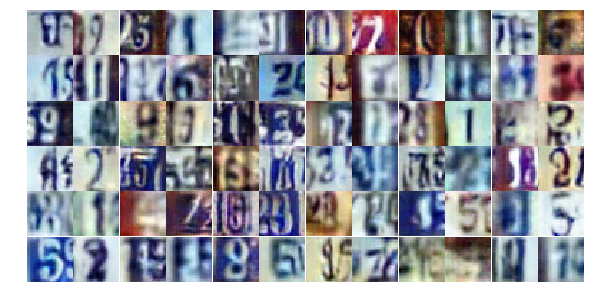

Epoch 18/25... Discriminator Loss: 0.9282... Generator Loss: 0.7543
Epoch 18/25... Discriminator Loss: 0.6657... Generator Loss: 1.0331
Epoch 18/25... Discriminator Loss: 0.8285... Generator Loss: 0.7975
Epoch 18/25... Discriminator Loss: 0.6669... Generator Loss: 1.1730
Epoch 18/25... Discriminator Loss: 0.6496... Generator Loss: 1.1246
Epoch 18/25... Discriminator Loss: 1.2115... Generator Loss: 1.5930
Epoch 18/25... Discriminator Loss: 0.8566... Generator Loss: 0.7841
Epoch 18/25... Discriminator Loss: 0.4556... Generator Loss: 1.4627
Epoch 18/25... Discriminator Loss: 0.8638... Generator Loss: 0.9274
Epoch 18/25... Discriminator Loss: 0.9099... Generator Loss: 0.7972


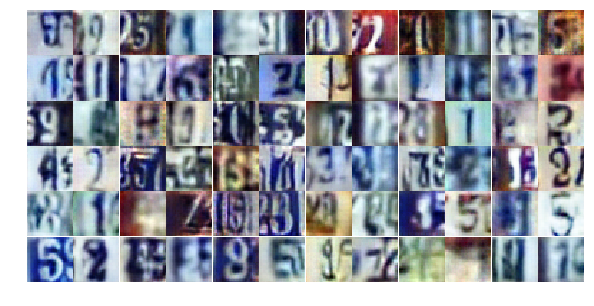

Epoch 18/25... Discriminator Loss: 1.0271... Generator Loss: 2.8379
Epoch 19/25... Discriminator Loss: 1.6249... Generator Loss: 0.3003
Epoch 19/25... Discriminator Loss: 1.0188... Generator Loss: 0.6492
Epoch 19/25... Discriminator Loss: 0.9285... Generator Loss: 0.7434
Epoch 19/25... Discriminator Loss: 0.6549... Generator Loss: 1.1731
Epoch 19/25... Discriminator Loss: 1.1145... Generator Loss: 0.6366
Epoch 19/25... Discriminator Loss: 0.5321... Generator Loss: 1.2763
Epoch 19/25... Discriminator Loss: 0.7550... Generator Loss: 1.0749
Epoch 19/25... Discriminator Loss: 0.7427... Generator Loss: 2.6321
Epoch 19/25... Discriminator Loss: 0.9172... Generator Loss: 0.7676


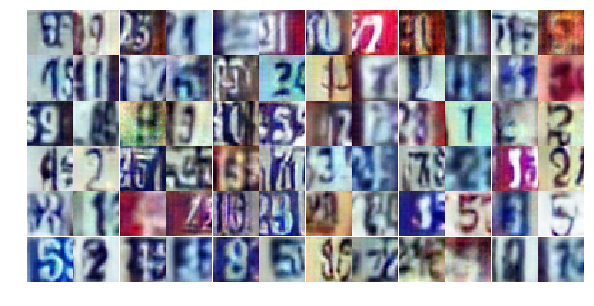

Epoch 19/25... Discriminator Loss: 0.8677... Generator Loss: 0.8693
Epoch 19/25... Discriminator Loss: 0.8755... Generator Loss: 0.7898
Epoch 19/25... Discriminator Loss: 0.8430... Generator Loss: 0.9031
Epoch 19/25... Discriminator Loss: 1.2363... Generator Loss: 0.4641
Epoch 19/25... Discriminator Loss: 0.9987... Generator Loss: 0.6825
Epoch 19/25... Discriminator Loss: 0.5943... Generator Loss: 1.3467
Epoch 19/25... Discriminator Loss: 1.1567... Generator Loss: 0.5233
Epoch 19/25... Discriminator Loss: 0.5762... Generator Loss: 1.3295
Epoch 19/25... Discriminator Loss: 0.9162... Generator Loss: 0.9906
Epoch 19/25... Discriminator Loss: 1.1152... Generator Loss: 0.5838


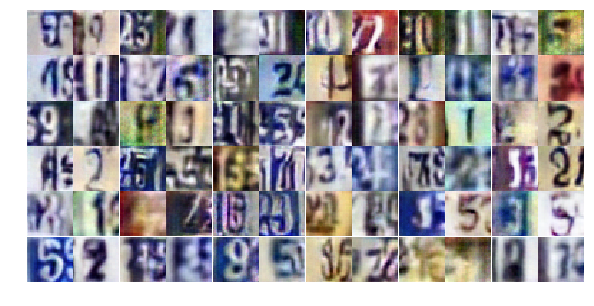

Epoch 19/25... Discriminator Loss: 0.6453... Generator Loss: 1.0077
Epoch 19/25... Discriminator Loss: 1.0304... Generator Loss: 0.6364


In [ ]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

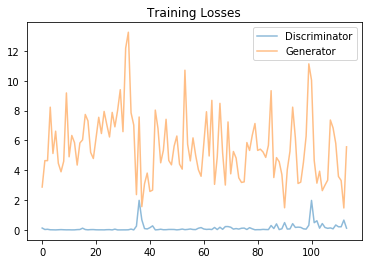

In [20]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

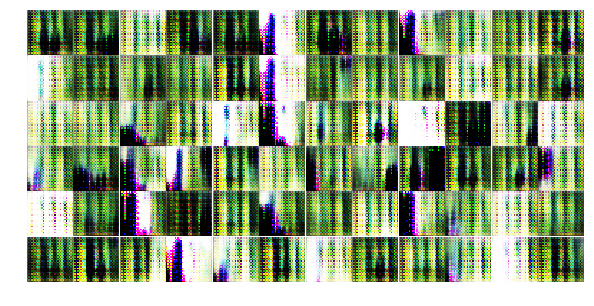

In [21]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))